# Regional specialization and fate specification of bone stromal cells in skeletal development.
Sivaraj KK, Jeong HW, Dharmalingam B, Zeuschner D et al., _Cell Rep_, 2021. PMID: [34260921](https://www.ncbi.nlm.nih.gov/pubmed/34260921)

GEO Accession: [GSE156635](https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSE156635)

In [260]:
suppressPackageStartupMessages({
    library(patchwork)
    library(SingleCellExperiment)
    library(Seurat)
    library(dplyr)
    library(Matrix)
    library(patchwork)
    library(ggplot2)
    library(SeuratWrappers)
})

options(repr.plot.width = 16, repr.plot.height = 8)

In [165]:
MSC.data <- readRDS(file = "MSC_EGFP_scater_QCfiltered.Rds")
MSC.data

class: SingleCellExperiment 
dim: 16537 27573 
metadata(0):
assays(1): counts
rownames(16537): Sox17 Gm37587 ... AC149090.1 EGFP
rowData names(11): ID Symbol ... total_counts log10_total_counts
colnames: NULL
colData names(38): Sample Barcode ... pct_counts_in_top_200_features_Mt
  pct_counts_in_top_500_features_Mt
reducedDimNames(0):
mainExpName: NULL
altExpNames(0):

In [166]:
MSC <- as.matrix(counts(MSC.data))
colnames(MSC) <- MSC.data$Barcode
# MSC

In [167]:
MSC <- CreateSeuratObject(MSC, assay = "RNA",
  names.field = 1,
  names.delim = "_",
  min.features = 200,
)

Warning message:
“The following arguments are not used: row.names”


In [168]:
MSC

An object of class Seurat 
16537 features across 27573 samples within 1 assay 
Active assay: RNA (16537 features, 0 variable features)

In [169]:
# metadata <- read.delim(file= "metadata_MSC_EGFP.txt", header =TRUE, row.names = 1)

In [170]:
# head(metadata)

In [171]:
# MSC <- AddMetaData(MSC, metadata = metadata)

In [172]:
head(MSC@meta.data, 4)

,orig.ident,nCount_RNA,nFeature_RNA
,<fct>,<dbl>,<int>
BSC_1_AAACCTGAGATAGCAT-1,BSC,4997,2339
BSC_1_AAACCTGAGGGTATCG-1,BSC,3275,1573
BSC_1_AAACCTGCAAACCCAT-1,BSC,2559,1434
BSC_1_AAACCTGGTCAACATC-1,BSC,3911,1751



# Control E13.5

In [173]:
MSC[["percent.mt"]] <- PercentageFeatureSet(MSC, pattern = "^mt-")

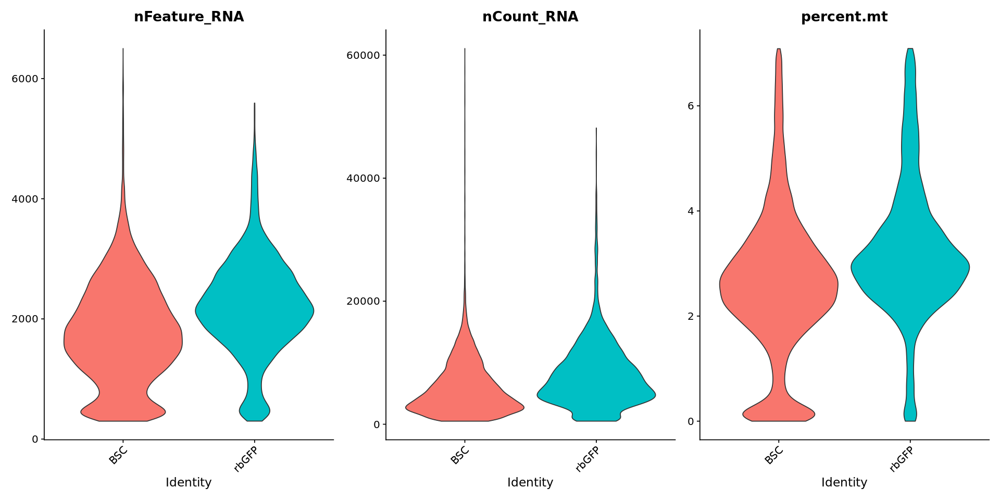

In [174]:
VlnPlot(MSC, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3, group.by= "orig.ident", pt.size = 0)

In [175]:
MSC <- subset(MSC, subset= percent.mt < 7)

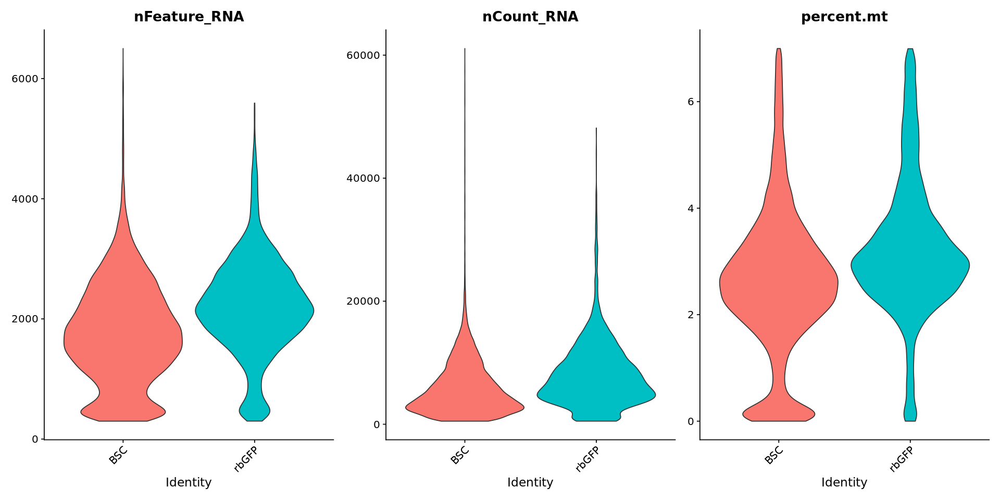

In [176]:
VlnPlot(MSC, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3, group.by= "orig.ident", pt.size = 0)

In [177]:
dim(MSC)

[1] 16537 27518

In [178]:
# write.table(as.matrix(GetAssayData(object = MSC, slot = "counts")), 
#             '/mnt/c/Users/r0636432/Documents/GSE156636/MSC.matrix.aftercontrol.csv', 
#             sep = ',', row.names = T, col.names = T, quote = F)

## Feature selection

We next calculate a subset of features that exhibit high cell-to-cell variation in the dataset (i.e, they are highly expressed in some cells, and lowly expressed in others). We and others have found that focusing on these genes in downstream analysis helps to highlight biological signal in single-cell datasets.

The procedure in Seurat v3 directly models the mean-variance relationship inherent in single-cell data, and is implemented in the `FindVariableFeatures` function. By default, it defaults to 2,000 features (genes) per dataset. These will be used in downstream analysis, like principal component analysis (PCA).

In [179]:
MSC <- NormalizeData(MSC, verbose = FALSE)
MSC <- FindVariableFeatures(MSC, selection.method = "vst", nfeatures = 2000)

# Identify the 10 most highly variable genes
top10 <- head(VariableFeatures(MSC), 10)

When using repel, set xnudge and ynudge to 0 for optimal results



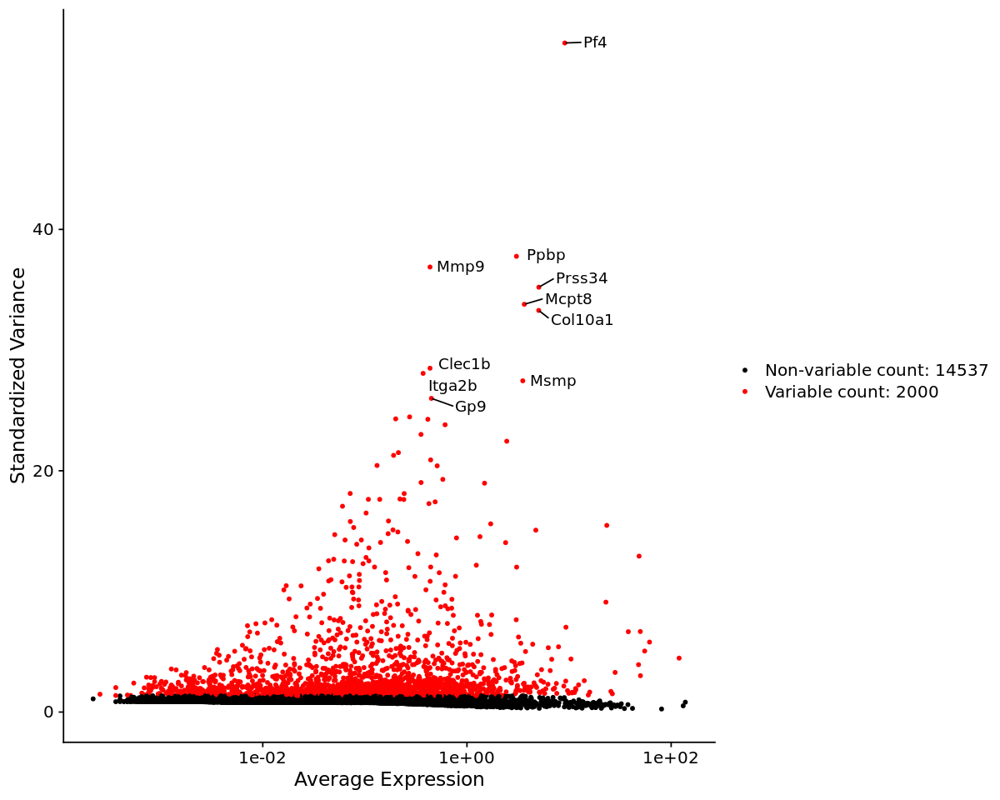

In [180]:
options(repr.plot.width=10)

# plot variable features with and without labels
plot1 <- VariableFeaturePlot(MSC)
plot2 <- LabelPoints(plot = plot1, points = top10, repel = TRUE)
plot2

## Scaling the data

Next, we apply a linear transformation ('scaling') that is a standard pre-processing step prior to dimensional reduction techniques like PCA. The ScaleData function:

- Shifts the expression of each gene, so that the mean expression across cells is 0
- Scales the expression of each gene, so that the variance across cells is 1
- This step gives equal weight in downstream analyses, so that highly-expressed genes do not dominate. This is superior to log-normalized counts, which overemphasize the influence of small count fluctuations.
- The results of this are stored in `pbmc[["RNA"]]@scale.data`

In [181]:
all.genes <- rownames(MSC)
MSC <- ScaleData(MSC, features = all.genes)

Centering and scaling data matrix



## Linear dimensionality reduction: PCA

Next we perform PCA on the scaled data. By default, only the previously determined variable features are used as input, but can be defined using features argument if you wish to choose a different subset.

In [182]:
MSC <- RunPCA(MSC, features = VariableFeatures(object = MSC), verbose = FALSE)

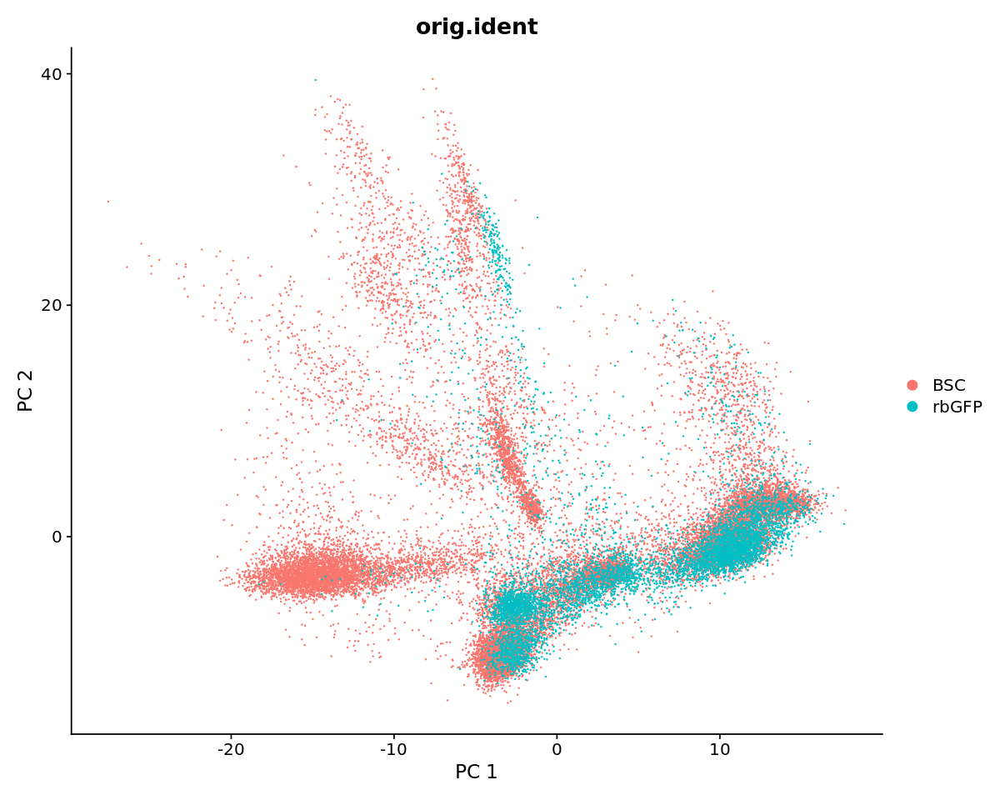

In [183]:
DimPlot(MSC, reduction = "pca", group.by = "orig.ident") + xlab("PC 1") + ylab("PC 2")

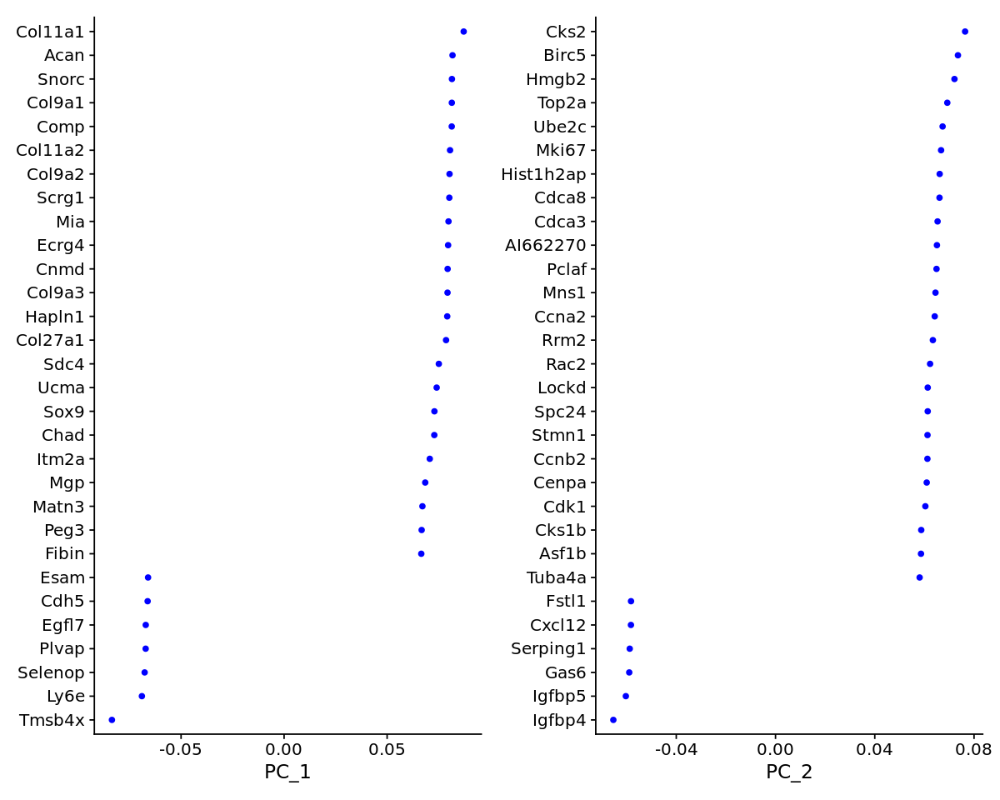

In [184]:
VizDimLoadings(MSC, dims = 1:2, reduction = "pca")

# Determine dimensionality

To overcome the extensive technical noise in any single feature for scRNA-seq data, Seurat clusters cells based on their PCA scores, with each PC essentially representing a 'metafeature' that combines information across a correlated feature set. The top principal components therefore represent a robust compression of the dataset. However, how many componenets should we choose to include? 

[Macosko et al](http://www.cell.com/abstract/S0092-8674(15)00549-8) introduced a resampling test inspired by the JackStraw procedure. They randomly permute a subset of the data (1% by default) and rerun PCA, constructing a 'null distribution' of feature scores, and repeat this procedure. 'Significant' PCs are defined as those who have a strong enrichment of low p-value features.

#### NOTE: This process can take a long time for big datasets, comment out for expediency. More approximate techniques such as those implemented in `ElbowPlot()` can be used to reduce computation time


The `JackStrawPlot` function provides a visualization tool for comparing the distribution of p-values for each PC with a uniform distribution (dashed line). 'Significant' PCs will show a strong enrichment of features with low p-values (solid curve above the dashed line). In this case it appears that there is a sharp drop-off in significance after the first 10-12 PCs.

In [185]:
#SynJ.integrated <- JackStraw(SynJ.integrated, num.replicate = 100)
#SynJ.integrated <- ScoreJackStraw(SynJ.integrated, dims = 1:20)

In [186]:
#JackStrawPlot(SynJ.integrated, dims = 1:15)

An alternative heuristic method generates an 'Elbow plot': a ranking of principle components based on the percentage of variance explained by each one (ElbowPlot function). In this example, the 'elbow' can be observed around PC9-10, suggesting that the majority of true signal is captured in the first 10 PCs.

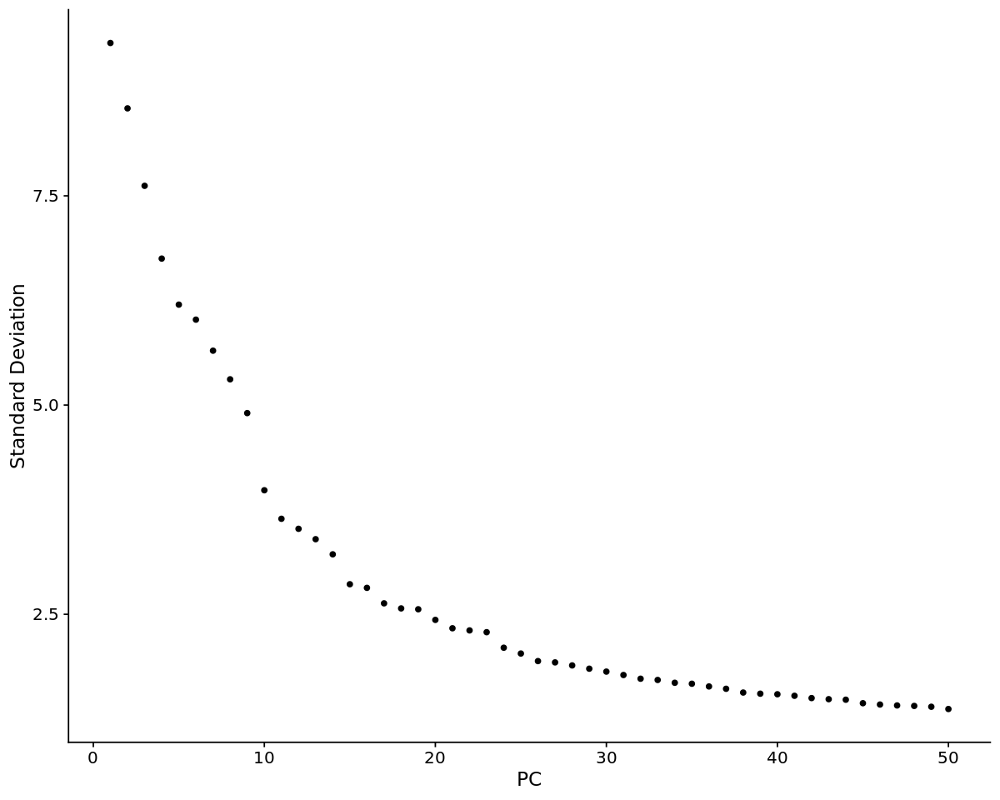

In [187]:
ElbowPlot(MSC, 50)

## Clustering the cells

Seurat v3 applies a graph-based clustering approach, building upon initial strategies in [Macosko et al](http://www.cell.com/abstract/S0092-8674(15)00549-8). Importantly, the distance metric which drives the clustering analysis (based on previously identified PCs) remains the same as in Seurat v2. However, the approach to partioning the cellular distance matrix into clusters has dramatically improved. The new method embeds cells in a graph structure - for example a K-nearest neighbor (KNN) graph, with edges drawn between cells with similar feature expression patterns, and then attempt to partition this graph into highly interconnected 'quasi-cliques' or 'communities'.

As in [PhenoGraph](https://doi.org/10.1016/j.cell.2015.05.047), Seurat first constructs a KNN graph based on the euclidean distance in PCA space, and refine the edge weights between any two cells based on the shared overlap in their local neighborhoods (Jaccard similarity). This step is performed using the `FindNeighbors` function, and takes as input the previously defined dimensionality of the dataset (first 10 PCs).

To cluster the cells, modularity optimization techniques such as the Louvain algorithm are then applied to iteratively group cells together, with the goal of optimizing the standard modularity function. The `FindClusters` function implements this procedure and contains a resolution parameter that sets the 'granularity' of the downstream clustering, with increased values leading to a greater number of clusters. Setting this parameter between 0.4-1.2 typically returns good results for single-cell datasets of around 3000 cells. Optimal resolution often increases for larger datasets.

In [188]:
MSC <- FindNeighbors(MSC, dims = 1:25)
MSC <- FindClusters(MSC, resolution = 0.11)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 27518
Number of edges: 977499

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9769
Number of communities: 11
Elapsed time: 6 seconds


## Non-linear dimensionality reduction: t-SNE and UMAP

Seurat offers several non-linear dimensional reduction techniques, such as tSNE and UMAP, to visualize and explore these datasets. The goal of these algorithms is to learn the underlying manifold of the data in order to place similar cells together in low-dimensional space. Cells within the graph-based clusters determined above should co-localize on these dimension reduction plots. As input to the UMAP and tSNE, [it is recommended to use the same PCs](https://doi.org/10.1038/s41467-019-13056-x) as input to the clustering analysis.

In [189]:
MSC <- RunUMAP(MSC, dims = 1:25, n.neighbors = 12)

16:41:34 UMAP embedding parameters a = 0.9922 b = 1.112

16:41:35 Read 27518 rows and found 25 numeric columns

16:41:35 Using Annoy for neighbor search, n_neighbors = 12

16:41:35 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:41:37 Writing NN index file to temp file /tmp/RtmpTslOeB/file23e4a2f3a6a

16:41:37 Searching Annoy index using 1 thread, search_k = 1200

16:41:41 Annoy recall = 100%

16:41:42 Commencing smooth kNN distance calibration using 1 thread

16:41:43 Initializing from normalized Laplacian + noise

16:41:44 Commencing optimization for 200 epochs, with 456738 positive edges

16:41:52 Optimization finished



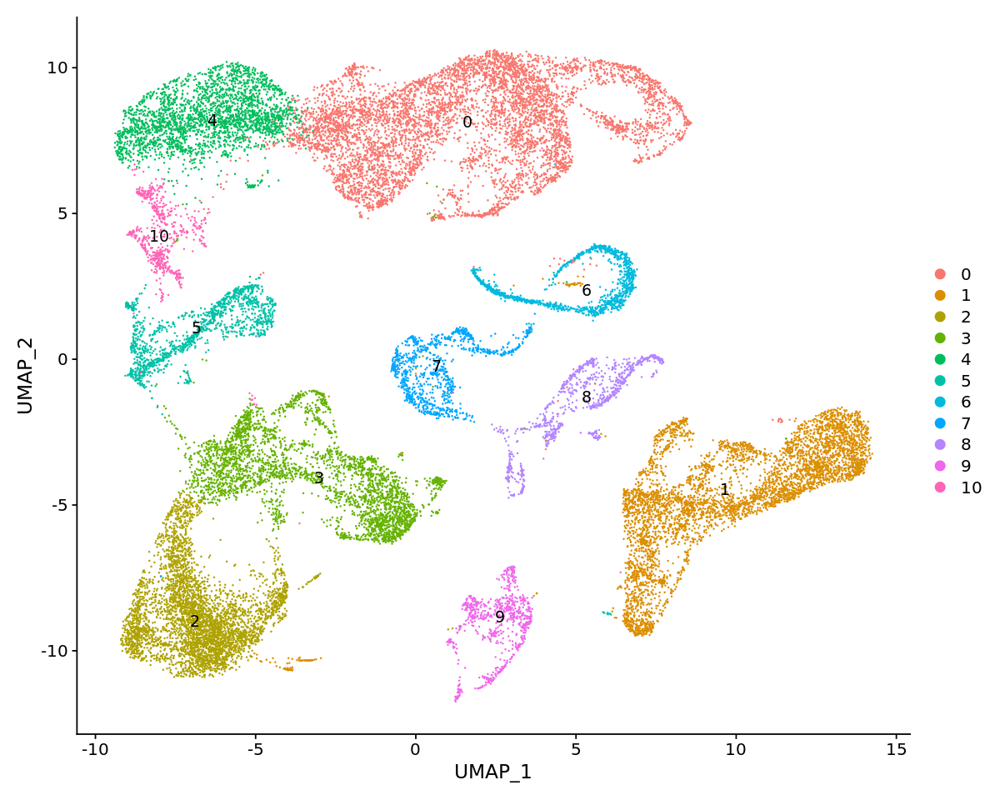

In [190]:
DimPlot(MSC, reduction = "umap", label=TRUE)

### Cluster 0: chondrocytes

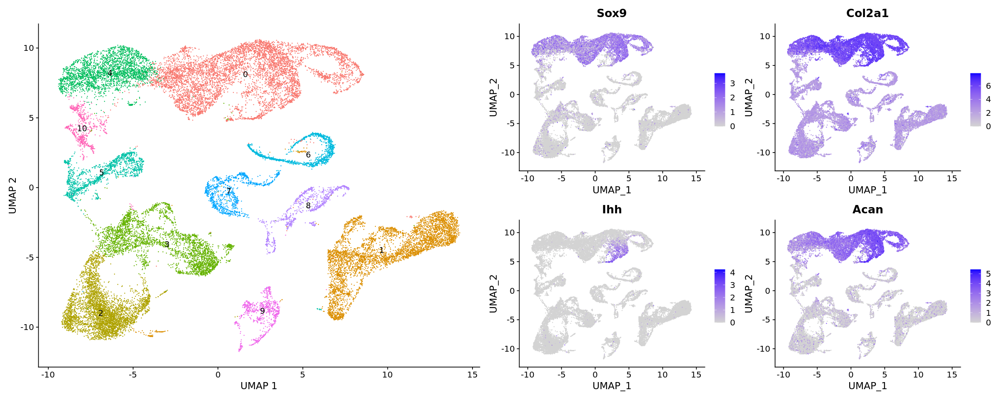

In [191]:
require(patchwork)

options(repr.plot.width = 20)

p1 <- DimPlot(MSC, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC, c("Sox9", "Col2a1", "Ihh", "Acan")) 

p1 + p2

### Cluster 1: endothelium

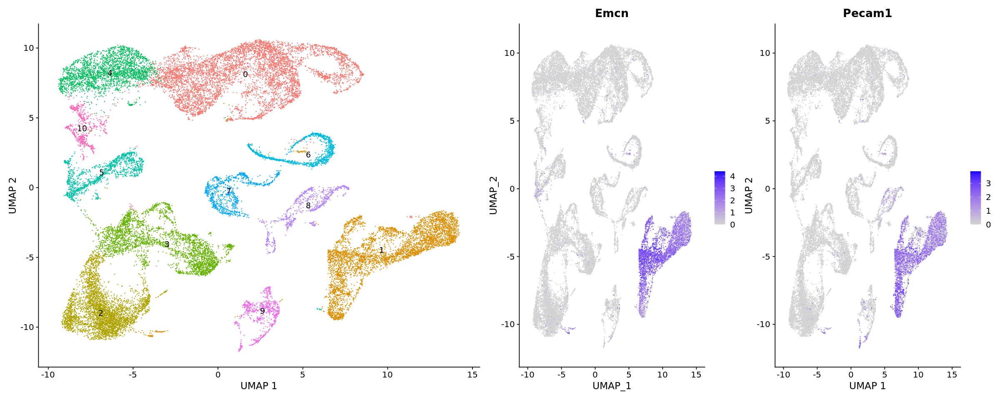

In [192]:
p1 <- DimPlot(MSC, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC, c("Emcn", "Pecam1")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 2: Adipocytes

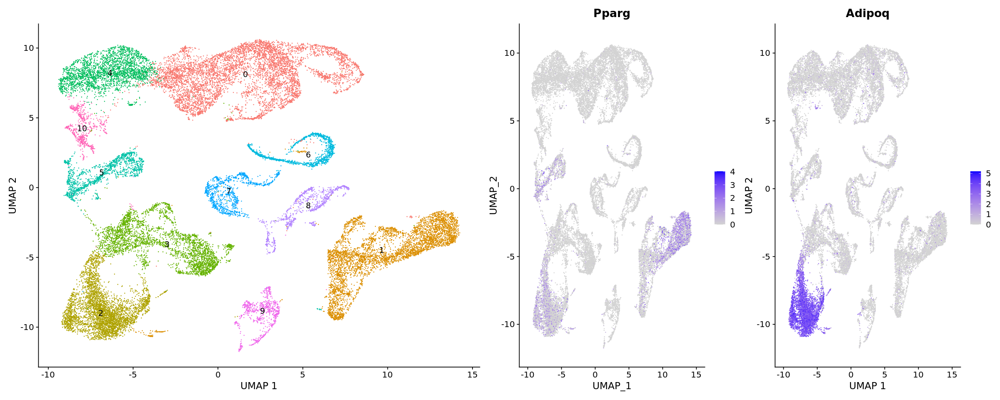

In [193]:
p1 <- DimPlot(MSC, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC, c("Pparg", "Adipoq")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 3: Osteoblasts

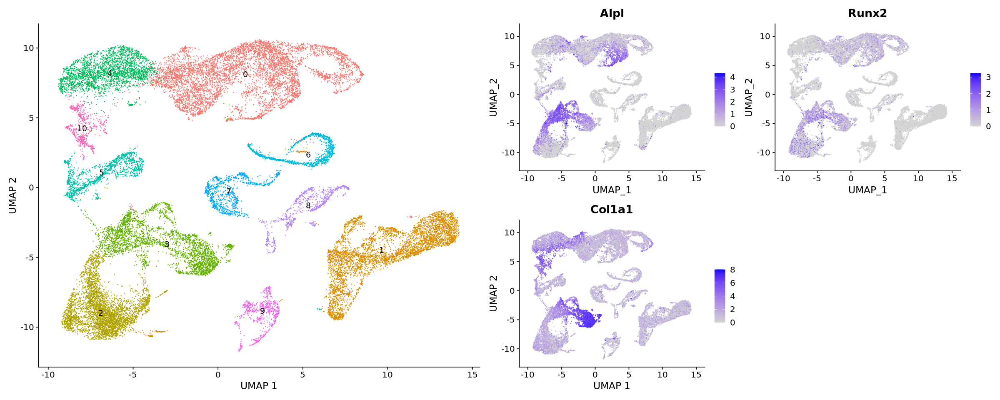

In [194]:
p1 <- DimPlot(MSC, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC, c("Alpl", "Runx2", "Col1a1")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 4: Articular chondrocytes

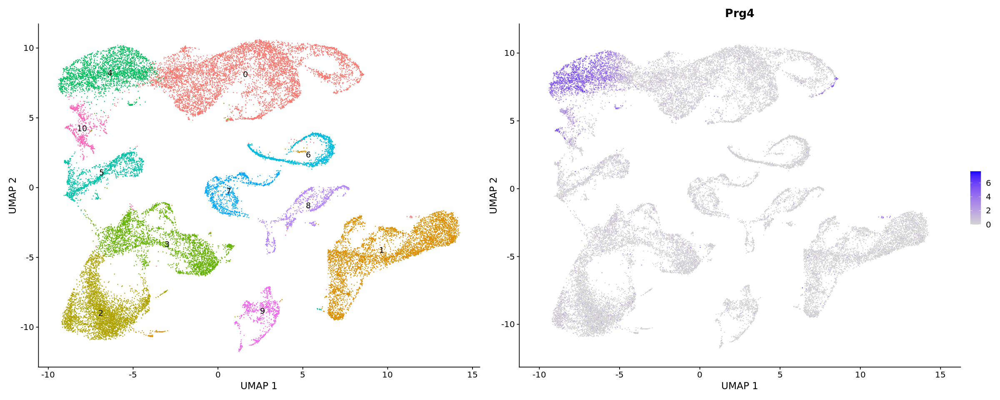

In [195]:
p1 <- DimPlot(MSC, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC, c("Prg4")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 5: Myocytes

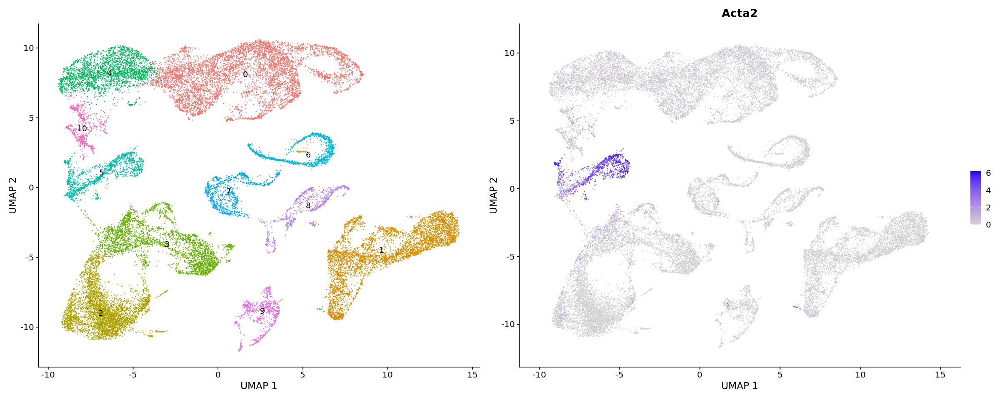

In [196]:
p1 <- DimPlot(MSC, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC, c("Acta2")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 6: Erythrocytes

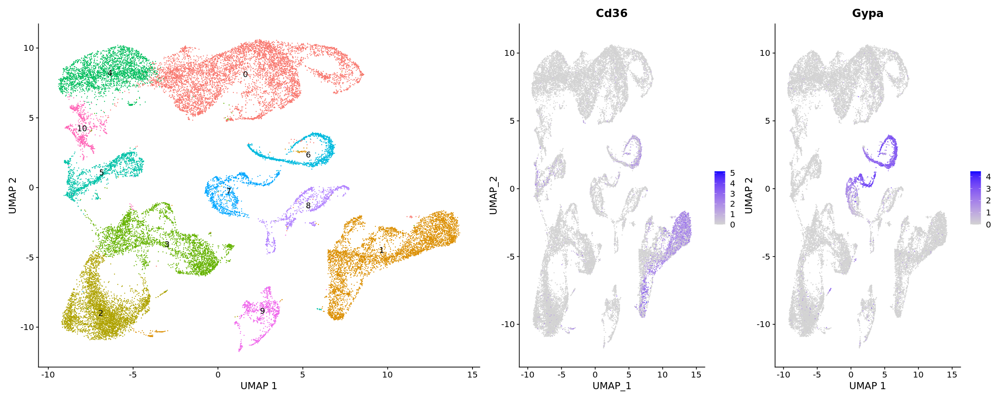

In [197]:
p1 <- DimPlot(MSC, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC, c("Cd36", "Gypa")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 7: Immune cells (myeloid)

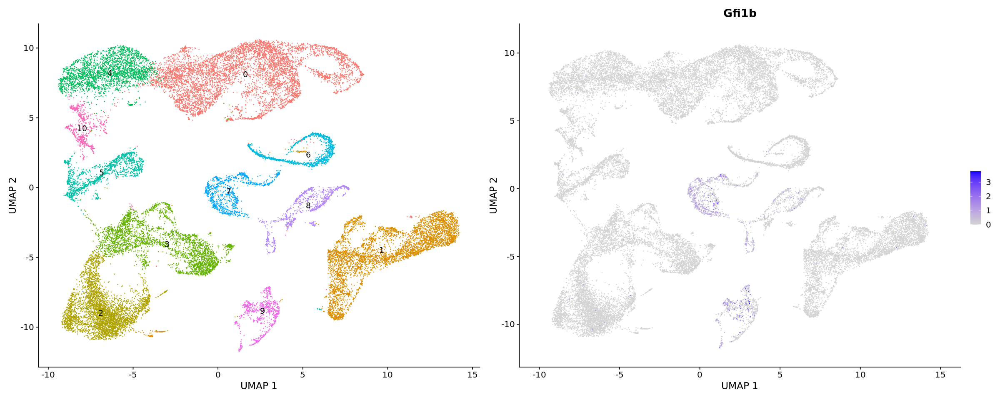

In [198]:
p1 <- DimPlot(MSC, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC, c("Gfi1b")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 8: Megakaryocytes

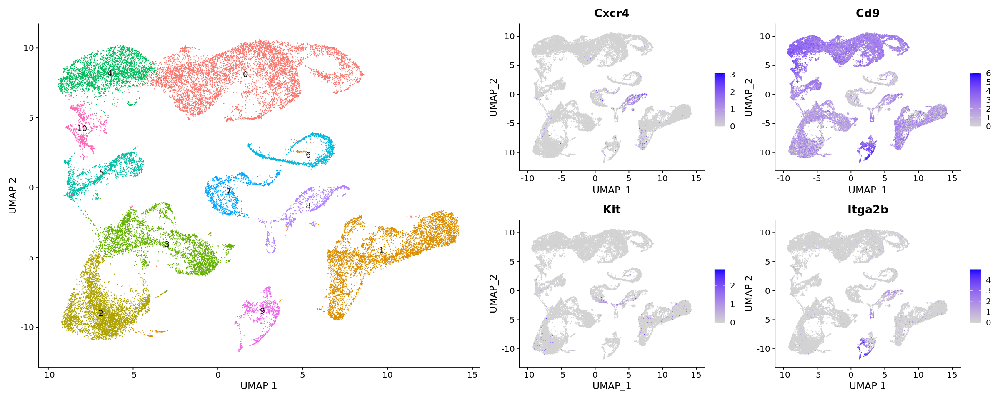

In [199]:
p1 <- DimPlot(MSC, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC, c("Cxcr4", "Cd9", "Kit", "Itga2b")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 9: Platelets

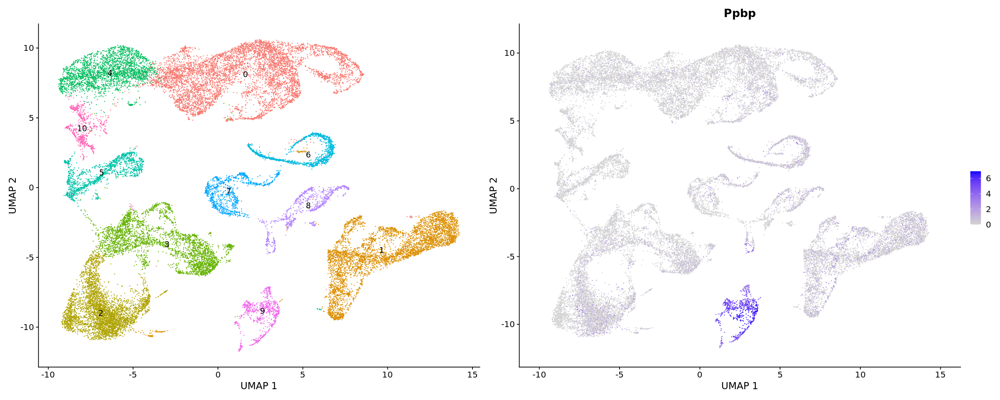

In [200]:
p1 <- DimPlot(MSC, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC, c("Ppbp")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 10: Tenocytes

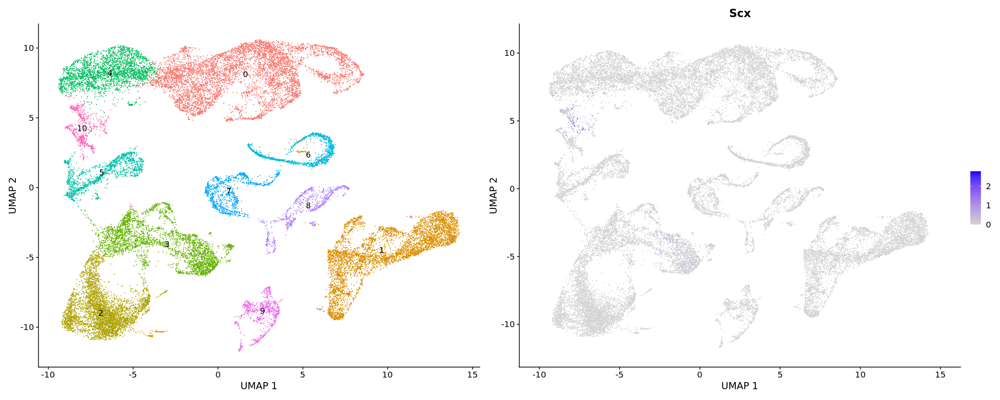

In [201]:
p1 <- DimPlot(MSC, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC, c("Scx")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

In [202]:
new.cluster.ids <- c("Chondrocytes", "Endothelial cells", "Adipocytes", "Osteoblasts", "Articular chondrocytes", 
                     "Myocytes", "Erythrocytes", "Immune cells", "Megakaryocytes", "Platelets", "Tenocytes")
#new.cluster.ids <- c("1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12", "13", "14", "15", "16", "17", "18", "19")
names(new.cluster.ids) <- levels(MSC)
MSC <- RenameIdents(MSC, new.cluster.ids)
MSC@meta.data$CellType = Idents(MSC)
#DimPlot(SynJ, reduction = "umap", pt.size = 0.5)

## Differential expression analysis

Seurat identifies markers that define clusters via differential expression. By default, it identifes positive and negative markers of a single cluster (specified in ident.1), compared to all other cells. `FindAllMarkers` automates this process for all clusters, but it is possible to test groups of clusters vs. each other, or against all cells.

The `min.pct` argument requires a feature to be detected at a minimum percentage in either of the two groups of cells, and the `thresh.test` argument requires a feature to be differentially expressed (on average) by some amount between the two groups. You can set both of these to 0, but with a dramatic increase in time - since this will test a large number of features that are unlikely to be highly discriminatory. As another option to speed up these computations, `max.cells.per.ident` can be set. This will downsample each identity class to have no more cells than whatever this is set to. While there is generally going to be a loss in power, the speed increases can be significiant and the most highly differentially expressed features will likely still rise to the top.

In [203]:
# default settings
MSC.markers <- FindAllMarkers(MSC, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

Calculating cluster Chondrocytes

Calculating cluster Endothelial cells

Calculating cluster Adipocytes

Calculating cluster Osteoblasts

Calculating cluster Articular chondrocytes

Calculating cluster Myocytes

Calculating cluster Erythrocytes

Calculating cluster Immune cells

Calculating cluster Megakaryocytes

Calculating cluster Platelets

Calculating cluster Tenocytes



In [204]:
#write.csv(MSC.markers, file="MSC.markers_EGFP.csv")

## Subsetting Chondrocyte clusters

In [206]:
MSC_Chondrocytes <- subset(MSC, idents = c("Articular chondrocytes", "Chondrocytes"))

In [207]:
MSC_Chondrocytes

An object of class Seurat 
16537 features across 9243 samples within 1 assay 
Active assay: RNA (16537 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [208]:
MSC_Chondrocytes <- ScaleData(MSC_Chondrocytes)

Centering and scaling data matrix



In [209]:
MSC_Chondrocytes <- RunPCA(MSC_Chondrocytes, features = VariableFeatures(object = MSC_Chondrocytes), verbose = FALSE)

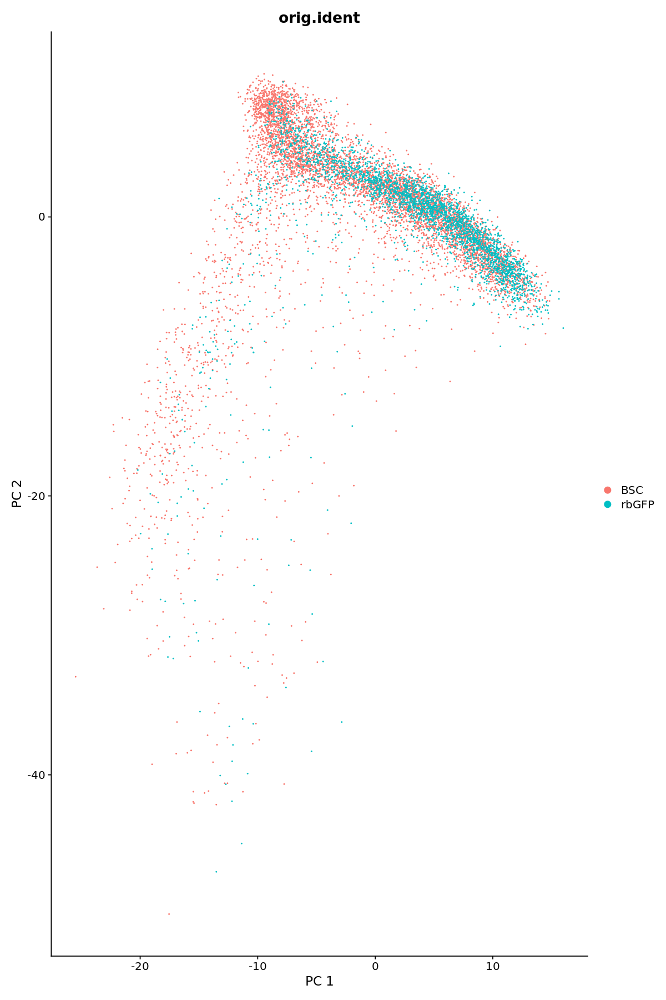

In [210]:
options(repr.plot.width=10)
DimPlot(MSC_Chondrocytes, reduction = "pca", group.by = "orig.ident") + xlab("PC 1") + ylab("PC 2")

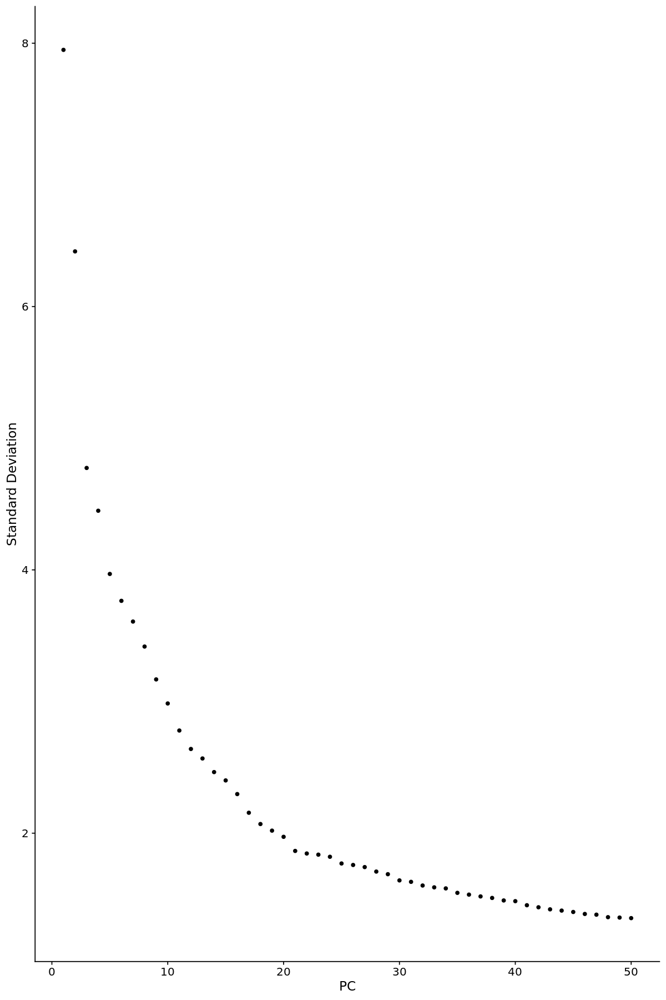

In [211]:
ElbowPlot(MSC_Chondrocytes, 50)

In [212]:
MSC_Chondrocytes <- FindNeighbors(MSC_Chondrocytes, dims = 1:15)
MSC_Chondrocytes <- FindClusters(MSC_Chondrocytes, resolution = 0.15)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 9243
Number of edges: 300285

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9331
Number of communities: 7
Elapsed time: 1 seconds


In [213]:
MSC_Chondrocytes <- RunUMAP(MSC_Chondrocytes, dims = 1:15, n.neighbors = 10)

16:51:21 UMAP embedding parameters a = 0.9922 b = 1.112

16:51:21 Read 9243 rows and found 15 numeric columns

16:51:21 Using Annoy for neighbor search, n_neighbors = 10

16:51:21 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:51:22 Writing NN index file to temp file /tmp/RtmpTslOeB/file23e6949245d

16:51:22 Searching Annoy index using 1 thread, search_k = 1000

16:51:23 Annoy recall = 100%

16:51:24 Commencing smooth kNN distance calibration using 1 thread

16:51:25 Initializing from normalized Laplacian + noise

16:51:25 Commencing optimization for 500 epochs, with 119502 positive edges

16:51:31 Optimization finished



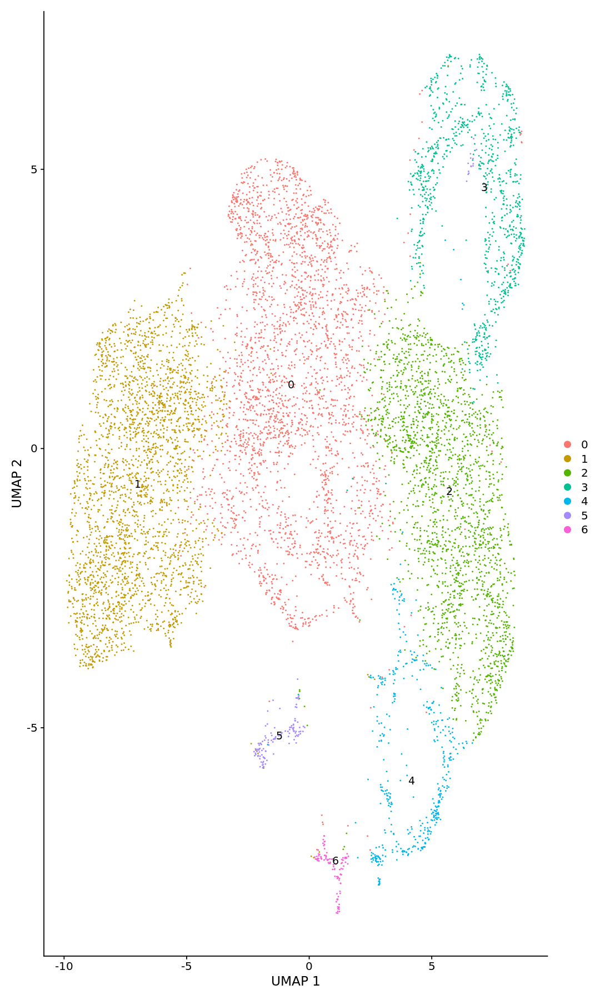

In [214]:
options(repr.plot.width = 9)
DimPlot(MSC_Chondrocytes, reduction = "umap", label=TRUE) + xlab("UMAP 1") + ylab("UMAP 2")

In [215]:
df <- FindAllMarkers(MSC_Chondrocytes)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6



In [216]:
# find markers for every cluster compared to all remaining cells, report only the positive
# ones
df %>%
    group_by(cluster) %>%
    slice_max(n = 2, order_by = avg_log2FC)

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,2.096645,0.577,0.153,0.000000e+00,0,Sfrp5
1.138234e-237,1.478396,0.729,0.511,1.882298e-233,0,Gpx3
0.000000e+00,4.928612,0.852,0.218,0.000000e+00,1,Prg4
6.449345e-275,3.916628,0.532,0.230,1.066528e-270,1,Cytl1
0.000000e+00,2.633093,0.993,0.600,0.000000e+00,2,Ppa1
0.000000e+00,1.973639,0.965,0.418,0.000000e+00,2,Fxyd2
0.000000e+00,3.080293,0.954,0.143,0.000000e+00,3,Stmn1
0.000000e+00,3.066190,0.975,0.327,0.000000e+00,3,Hmgb2
9.107715e-238,6.040653,0.817,0.261,1.506143e-233,4,Col10a1


### Cluster 0: Resting zone chondrocytes

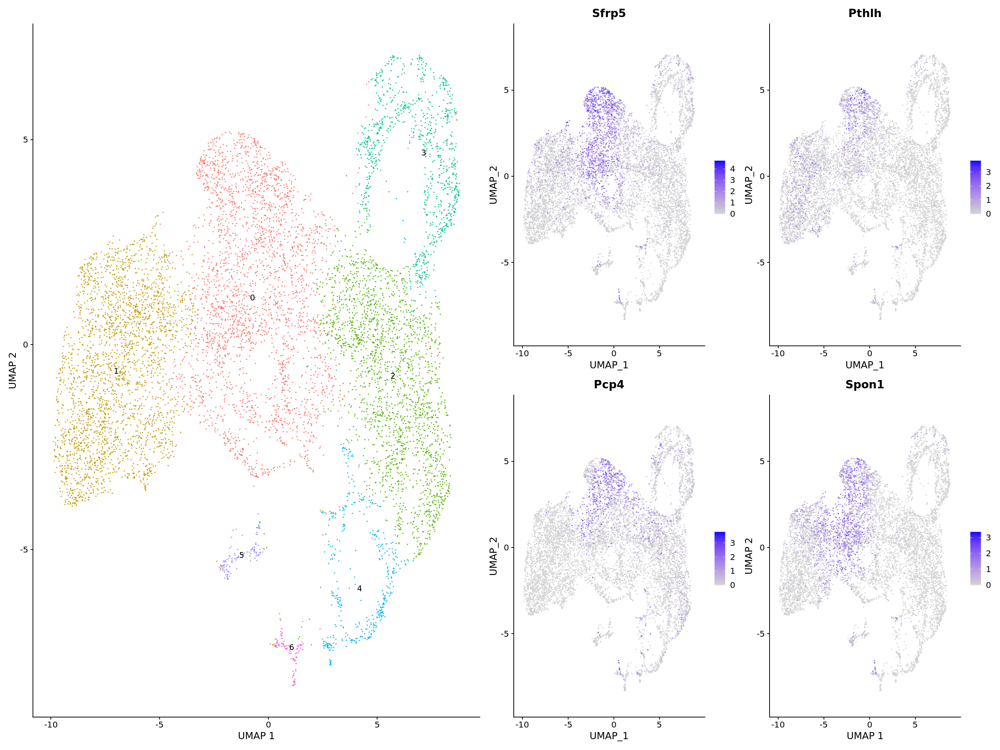

In [217]:
options(repr.plot.width = 20)

p1 <- DimPlot(MSC_Chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC_Chondrocytes, c("Sfrp5", "Pthlh", "Pcp4", "Spon1")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 1: Articular chondrocytes

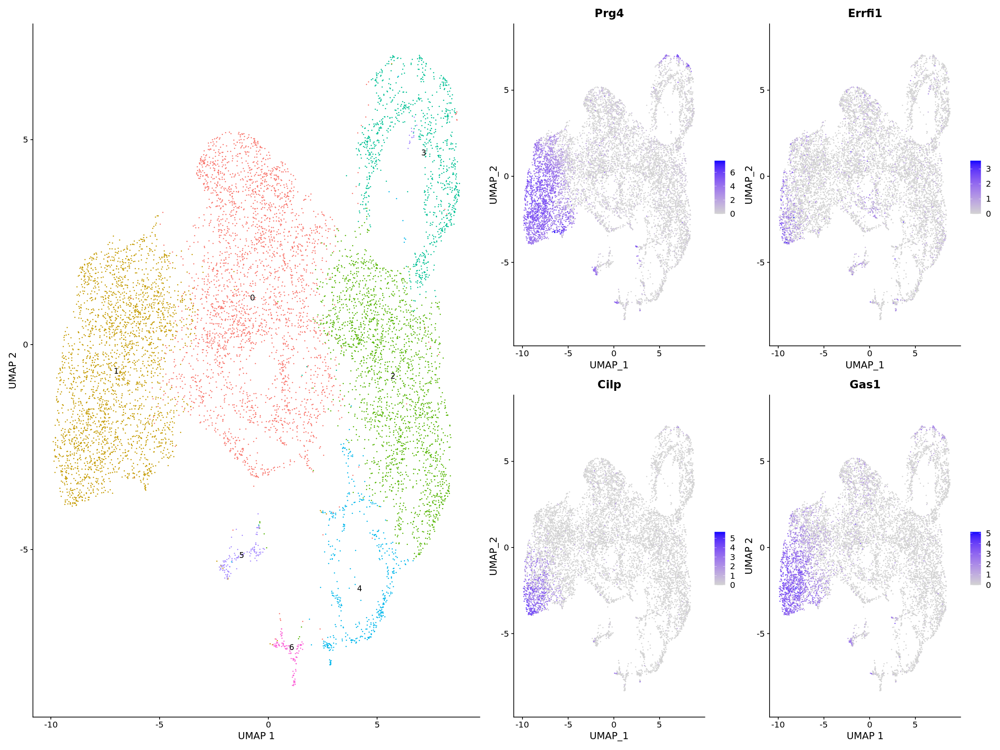

In [218]:
p1 <- DimPlot(MSC_Chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC_Chondrocytes, c("Prg4", "Errfi1", "Cilp", "Gas1")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 2: Prehypertrophic chondrocytes

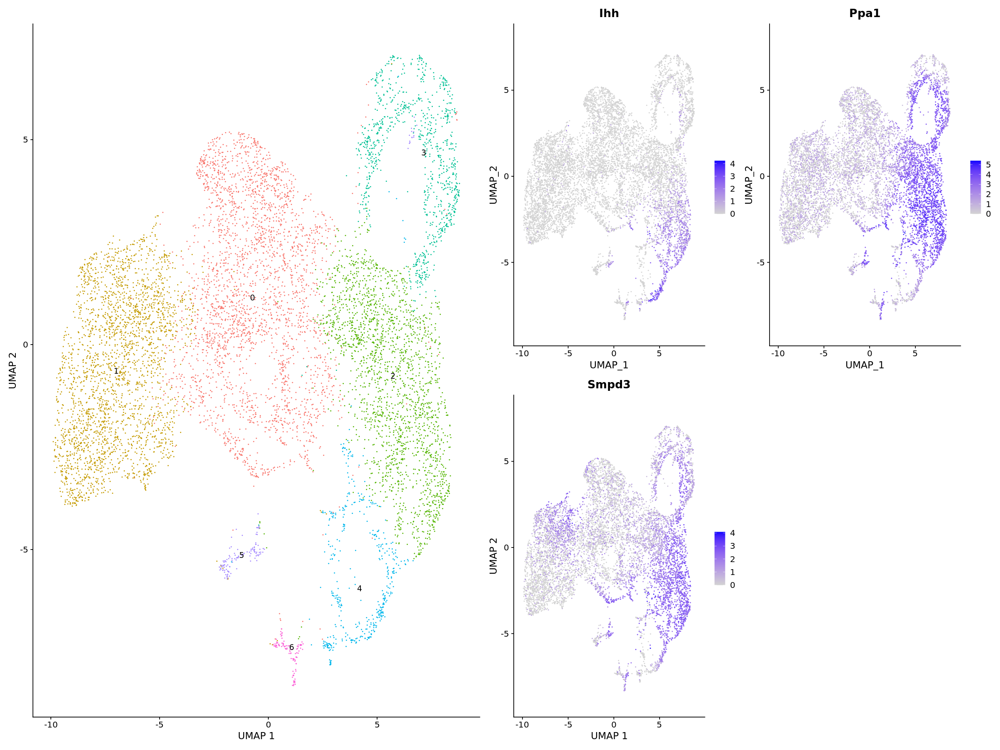

In [219]:
options(repr.plot.width = 20)

p1 <- DimPlot(MSC_Chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC_Chondrocytes, c("Ihh", "Ppa1", "Smpd3")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 3:  Proliferative chondrocytes

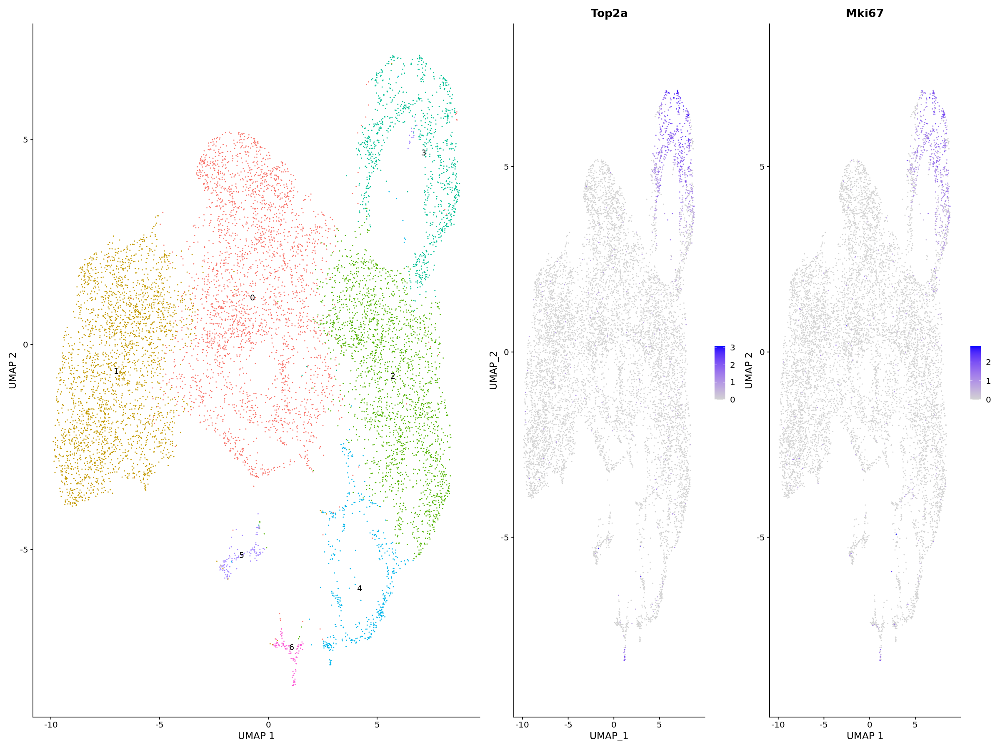

In [220]:
p1 <- DimPlot(MSC_Chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC_Chondrocytes, c("Top2a", "Mki67")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

### Cluster 4: Hypertrophic chondrocytes 

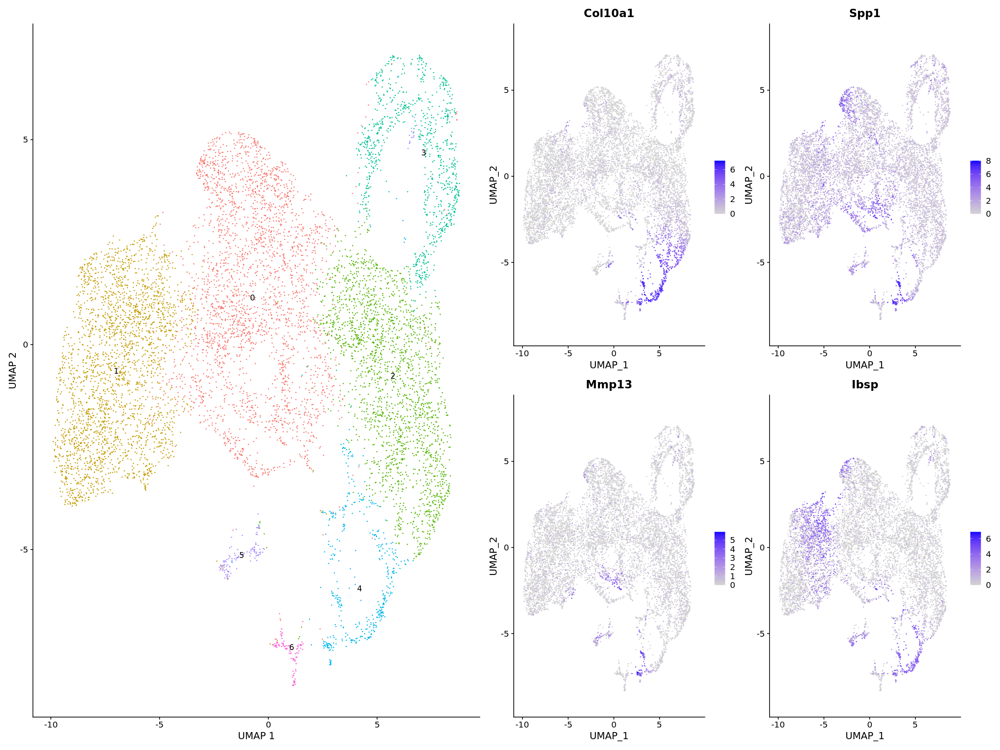

In [221]:
p1 <- DimPlot(MSC_Chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC_Chondrocytes, c("Col10a1", "Spp1", "Mmp13", "Ibsp"))

p1 + p2

### Cluster 5: Adipocytes

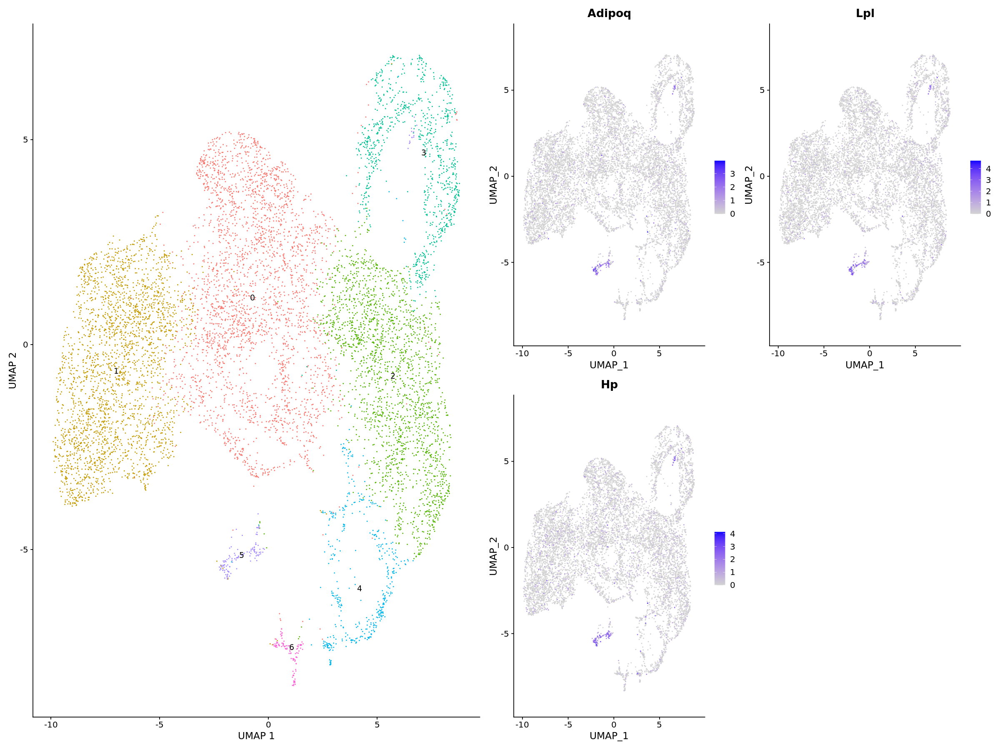

In [222]:
p1 <- DimPlot(MSC_Chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC_Chondrocytes, c("Adipoq", "Lpl", "Hp"))

p1 + p2

## Cluster 6: endothelial cells

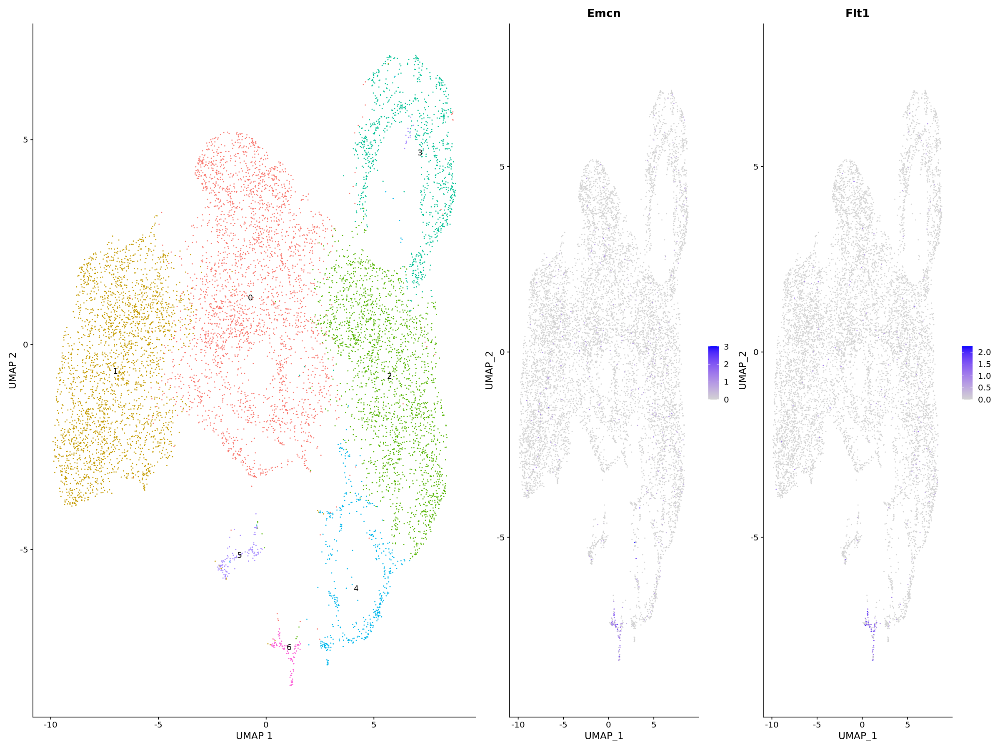

In [223]:
p1 <- DimPlot(MSC_Chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC_Chondrocytes, c("Emcn", "Flt1"))

p1 + p2

In [224]:
new.cluster.ids <- c("Resting zone chondrocytes", "Articular chondrocytes", "Pre-hypertrophic chondrocytes", "Proliferative chondrocytes", "Hypertrophic chondrocytes",
                     "Adipocytes", "Endothelial cells")
names(new.cluster.ids) <- levels(MSC_Chondrocytes)
MSC_Chondrocytes <- RenameIdents(MSC_Chondrocytes, new.cluster.ids)
MSC_Chondrocytes@meta.data$labels_chondro = Idents(MSC_Chondrocytes)

## Subsetting Osteoblast cluster

In [225]:
MSC_Osteoblasts <- subset(MSC, idents = c("Osteoblasts"))

In [226]:
MSC_Osteoblasts <- RunPCA(MSC_Osteoblasts, features = VariableFeatures(object = MSC_Osteoblasts), verbose = FALSE)

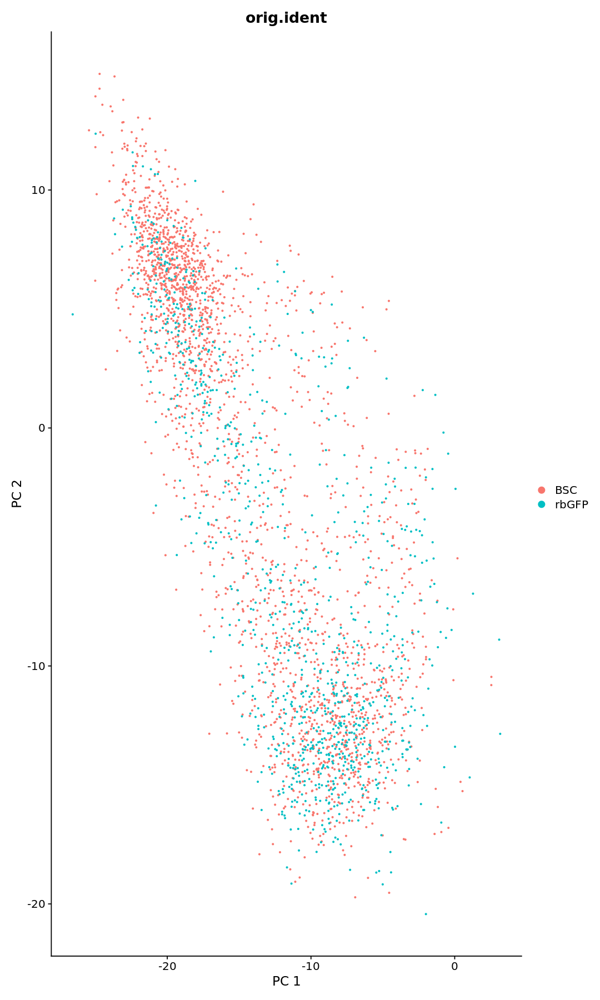

In [227]:
options(repr.plot.width = 9)

DimPlot(MSC_Osteoblasts, reduction = "pca", group.by = "orig.ident") + xlab("PC 1") + ylab("PC 2")

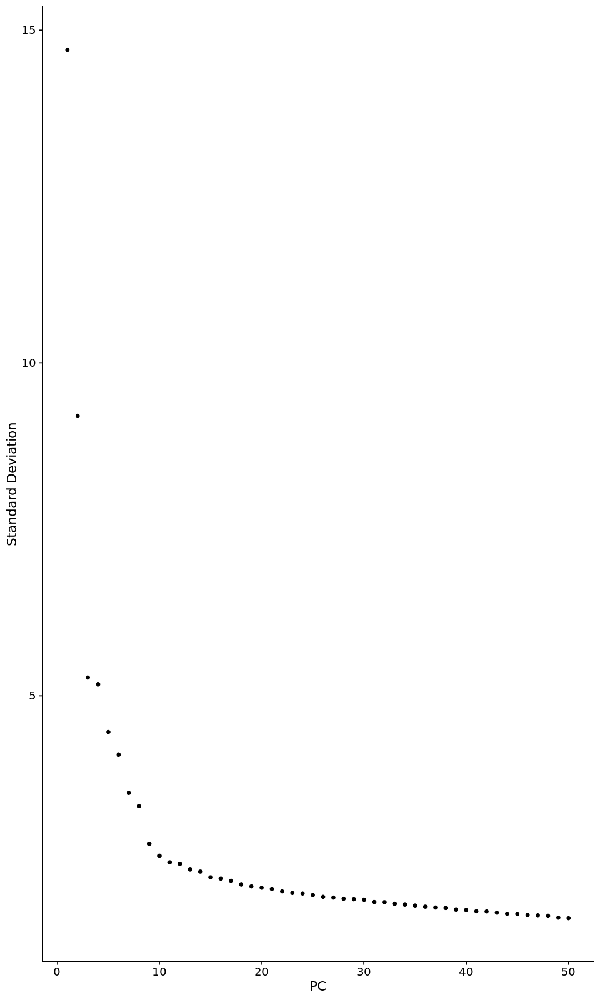

In [228]:
ElbowPlot(MSC_Osteoblasts, 50)

In [229]:
MSC_Osteoblasts <- FindNeighbors(MSC_Osteoblasts, dims = 1:10)
MSC_Osteoblasts <- FindClusters(MSC_Osteoblasts, resolution = 0.1)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3296
Number of edges: 107675

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9406
Number of communities: 4
Elapsed time: 0 seconds


In [230]:
MSC_Osteoblasts <- RunUMAP(MSC_Osteoblasts, dims = 1:10, n.neighbors = 10)

16:54:26 UMAP embedding parameters a = 0.9922 b = 1.112

16:54:26 Read 3296 rows and found 10 numeric columns

16:54:26 Using Annoy for neighbor search, n_neighbors = 10

16:54:26 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:54:27 Writing NN index file to temp file /tmp/RtmpTslOeB/file23e476071be

16:54:27 Searching Annoy index using 1 thread, search_k = 1000

16:54:27 Annoy recall = 100%

16:54:28 Commencing smooth kNN distance calibration using 1 thread

16:54:29 Initializing from normalized Laplacian + noise

16:54:29 Commencing optimization for 500 epochs, with 41774 positive edges

16:54:31 Optimization finished



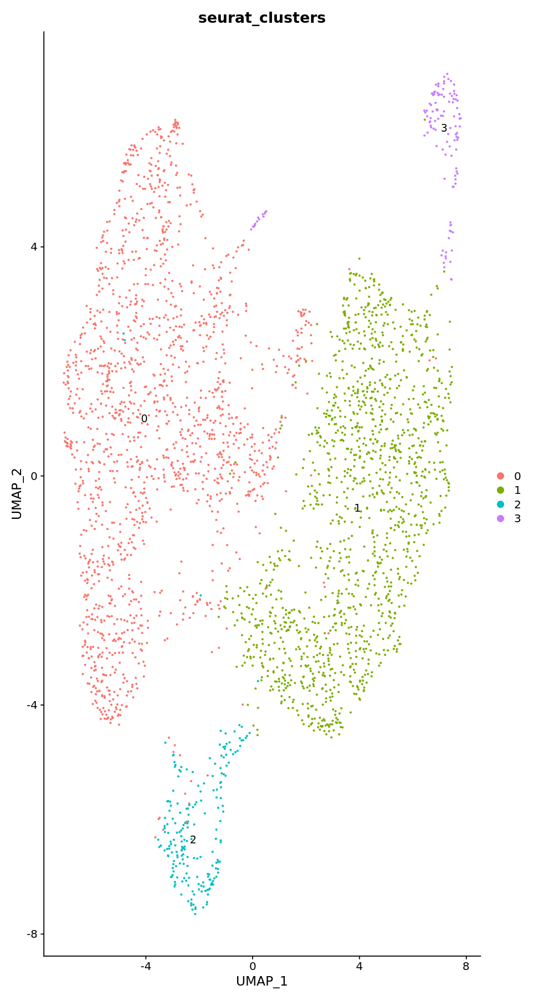

In [231]:
options(repr.plot.width=8)
DimPlot(MSC_Osteoblasts, reduction = "umap", label=TRUE, group.by = "seurat_clusters")

### Cluster 3: Osteocytes

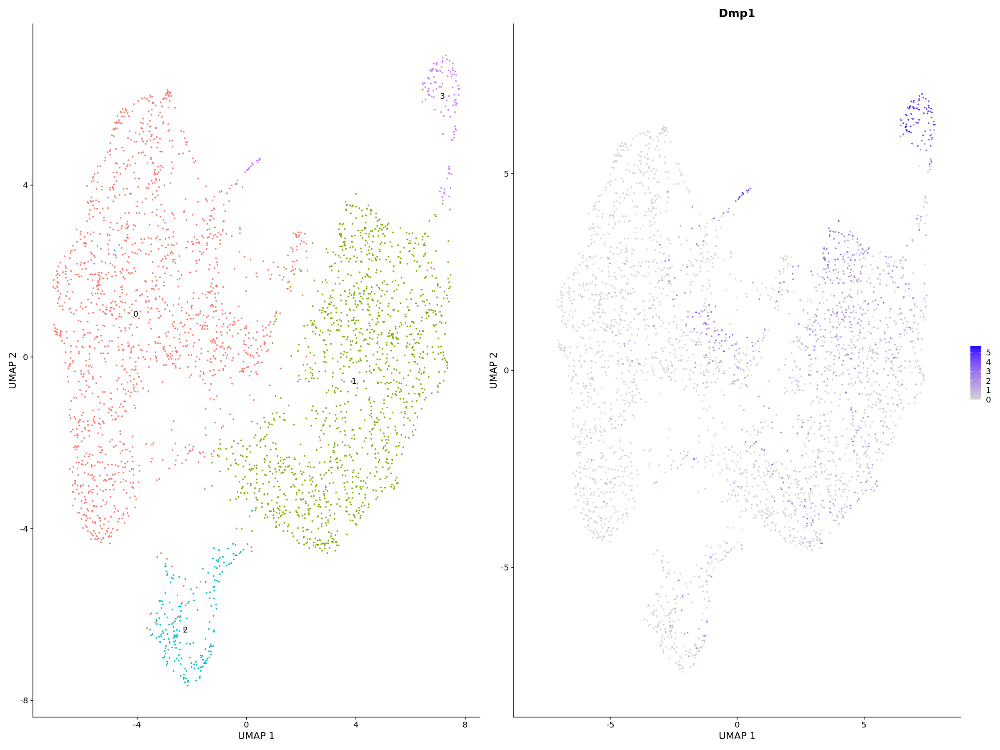

In [232]:
options(repr.plot.width = 20)

p1 <- DimPlot(MSC_Osteoblasts, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(MSC_Osteoblasts, c("Dmp1")) + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

In [233]:
new.cluster.ids <- c("Osteoblasts", "Osteoblasts", "Osteoblasts", "Osteocytes")

names(new.cluster.ids) <- levels(MSC_Osteoblasts)
MSC_Osteoblasts <- RenameIdents(MSC_Osteoblasts, new.cluster.ids)
MSC_Osteoblasts@meta.data$labels_osteo = Idents(MSC_Osteoblasts)

# Integrate new clusters in the MSC metadata

In [234]:
meta1 <- MSC@meta.data
meta2 <- MSC_Osteoblasts@meta.data

In [235]:
df <- split(meta1, meta1$CellType)

In [236]:
osteoblasts <- rownames(df$Osteoblasts)

In [237]:
osteometa <- meta2[osteoblasts, c("labels_osteo", "orig.ident")]
osteometa$orig.ident <- NULL

head(osteometa)

,labels_osteo
,<fct>
BSC_1_AAAGTAGGTCTAAACC-1,Osteoblasts
BSC_1_AACACGTAGCTCCTCT-1,Osteoblasts
BSC_1_AACCGCGTCACGACTA-1,Osteoblasts
BSC_1_AACGTTGCAGGGTACA-1,Osteoblasts
BSC_1_AACTCAGGTGCGGTAA-1,Osteoblasts
BSC_1_AACTCTTCACTATCTT-1,Osteoblasts


In [238]:
df$Osteoblasts <- cbind(df$Osteoblasts, osteometa)
df$Osteoblasts$CellType <- df$Osteoblasts$labels_osteo
df$Osteoblasts$labels_osteo <- NULL

In [239]:
str(df)

List of 11
 $ Chondrocytes          :'data.frame':	6541 obs. of  7 variables:
  ..$ orig.ident      : Factor w/ 2 levels "BSC","rbGFP": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ nCount_RNA      : num [1:6541] 3911 8005 4483 7027 11660 ...
  ..$ nFeature_RNA    : int [1:6541] 1751 2395 1414 2103 2977 2029 2272 1802 2393 2387 ...
  ..$ percent.mt      : num [1:6541] 3.14 2.8 5.2 1.45 3.04 ...
  ..$ RNA_snn_res.0.11: Factor w/ 11 levels "0","1","2","3",..: 1 1 1 1 1 1 1 1 1 1 ...
  ..$ seurat_clusters : Factor w/ 11 levels "0","1","2","3",..: 1 1 1 1 1 1 1 1 1 1 ...
  ..$ CellType        : Factor w/ 11 levels "Chondrocytes",..: 1 1 1 1 1 1 1 1 1 1 ...
 $ Endothelial cells     :'data.frame':	4867 obs. of  7 variables:
  ..$ orig.ident      : Factor w/ 2 levels "BSC","rbGFP": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ nCount_RNA      : num [1:4867] 4997 626 2232 7320 2306 ...
  ..$ nFeature_RNA    : int [1:4867] 2339 443 1182 2742 1262 1099 1503 1090 868 728 ...
  ..$ percent.mt      : num [1:4867] 3.02 1.44 2.82 1

In [240]:
chondrocytes <- rownames(df$Chondrocytes)

In [241]:
meta2 <- MSC_Chondrocytes@meta.data
chondrometa <- meta2[chondrocytes, c("labels_chondro", "orig.ident")]
chondrometa$orig.ident <- NULL

head(chondrometa)

,labels_chondro
,<fct>
BSC_1_AAACCTGGTCAACATC-1,Resting zone chondrocytes
BSC_1_AAACGGGTCAACACCA-1,Proliferative chondrocytes
BSC_1_AAAGATGAGCTGTTCA-1,Resting zone chondrocytes
BSC_1_AAAGCAAAGCTAAACA-1,Proliferative chondrocytes
BSC_1_AAAGCAACAGGGAGAG-1,Pre-hypertrophic chondrocytes
BSC_1_AAATGCCAGGCACATG-1,Proliferative chondrocytes


In [242]:
df$Chondrocytes <- cbind(df$Chondrocytes, chondrometa)
df$Chondrocytes$CellType <- df$Chondrocytes$labels_chondro

In [243]:
df$Osteoblasts <- cbind(df$Osteoblasts, osteometa)
df$Osteoblasts$CellType <- df$Osteoblasts$labels_osteo

In [244]:
df$Osteoblasts$Barcode = rownames(df$Osteoblasts)
df$Chondrocytes$Barcode = rownames(df$Chondrocytes)

### make sure all dataframes in the list have the same number of columns, in the same order

In [245]:
str(df)

List of 11
 $ Chondrocytes          :'data.frame':	6541 obs. of  9 variables:
  ..$ orig.ident      : Factor w/ 2 levels "BSC","rbGFP": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ nCount_RNA      : num [1:6541] 3911 8005 4483 7027 11660 ...
  ..$ nFeature_RNA    : int [1:6541] 1751 2395 1414 2103 2977 2029 2272 1802 2393 2387 ...
  ..$ percent.mt      : num [1:6541] 3.14 2.8 5.2 1.45 3.04 ...
  ..$ RNA_snn_res.0.11: Factor w/ 11 levels "0","1","2","3",..: 1 1 1 1 1 1 1 1 1 1 ...
  ..$ seurat_clusters : Factor w/ 11 levels "0","1","2","3",..: 1 1 1 1 1 1 1 1 1 1 ...
  ..$ CellType        : Factor w/ 7 levels "Resting zone chondrocytes",..: 1 4 1 4 3 4 4 1 1 1 ...
  ..$ labels_chondro  : Factor w/ 7 levels "Resting zone chondrocytes",..: 1 4 1 4 3 4 4 1 1 1 ...
  ..$ Barcode         : chr [1:6541] "BSC_1_AAACCTGGTCAACATC-1" "BSC_1_AAACGGGTCAACACCA-1" "BSC_1_AAAGATGAGCTGTTCA-1" "BSC_1_AAAGCAAAGCTAAACA-1" ...
 $ Endothelial cells     :'data.frame':	4867 obs. of  7 variables:
  ..$ orig.ident      : Fact

In [246]:
df$Chondrocytes$labels_chondro <- NULL
df$Osteoblasts$labels_osteo <- NULL

In [247]:
str(df)

List of 11
 $ Chondrocytes          :'data.frame':	6541 obs. of  8 variables:
  ..$ orig.ident      : Factor w/ 2 levels "BSC","rbGFP": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ nCount_RNA      : num [1:6541] 3911 8005 4483 7027 11660 ...
  ..$ nFeature_RNA    : int [1:6541] 1751 2395 1414 2103 2977 2029 2272 1802 2393 2387 ...
  ..$ percent.mt      : num [1:6541] 3.14 2.8 5.2 1.45 3.04 ...
  ..$ RNA_snn_res.0.11: Factor w/ 11 levels "0","1","2","3",..: 1 1 1 1 1 1 1 1 1 1 ...
  ..$ seurat_clusters : Factor w/ 11 levels "0","1","2","3",..: 1 1 1 1 1 1 1 1 1 1 ...
  ..$ CellType        : Factor w/ 7 levels "Resting zone chondrocytes",..: 1 4 1 4 3 4 4 1 1 1 ...
  ..$ Barcode         : chr [1:6541] "BSC_1_AAACCTGGTCAACATC-1" "BSC_1_AAACGGGTCAACACCA-1" "BSC_1_AAAGATGAGCTGTTCA-1" "BSC_1_AAAGCAAAGCTAAACA-1" ...
 $ Endothelial cells     :'data.frame':	4867 obs. of  7 variables:
  ..$ orig.ident      : Factor w/ 2 levels "BSC","rbGFP": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ nCount_RNA      : num [1:4867] 4997 626

In [248]:
names(df)

[1] "Chondrocytes"           "Endothelial cells"      "Adipocytes"            
 [4] "Osteoblasts"            "Articular chondrocytes" "Myocytes"              
 [7] "Erythrocytes"           "Immune cells"           "Megakaryocytes"        
[10] "Platelets"              "Tenocytes"

In [249]:
df$`Endothelial cells`$Barcode <- rownames(df$`Endothelial cells`)
df$Adipocytes$Barcode <- rownames(df$Adipocytes)
df$`Articular chondrocytes`$Barcode <- rownames(df$`Articular chondrocytes`)
df$Myocytes$Barcode <- rownames(df$Myocytes)
df$Erythrocytes$Barcode <- rownames(df$Erythrocytes)
df$`Immune cells`$Barcode <- rownames(df$`Immune cells`)
df$Megakaryocytes$Barcode <- rownames(df$Megakaryocytes)
df$Platelets$Barcode <- rownames(df$Platelets)
df$Tenocytes$Barcode <- rownames(df$Tenocytes)

In [250]:
str(df)

List of 11
 $ Chondrocytes          :'data.frame':	6541 obs. of  8 variables:
  ..$ orig.ident      : Factor w/ 2 levels "BSC","rbGFP": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ nCount_RNA      : num [1:6541] 3911 8005 4483 7027 11660 ...
  ..$ nFeature_RNA    : int [1:6541] 1751 2395 1414 2103 2977 2029 2272 1802 2393 2387 ...
  ..$ percent.mt      : num [1:6541] 3.14 2.8 5.2 1.45 3.04 ...
  ..$ RNA_snn_res.0.11: Factor w/ 11 levels "0","1","2","3",..: 1 1 1 1 1 1 1 1 1 1 ...
  ..$ seurat_clusters : Factor w/ 11 levels "0","1","2","3",..: 1 1 1 1 1 1 1 1 1 1 ...
  ..$ CellType        : Factor w/ 7 levels "Resting zone chondrocytes",..: 1 4 1 4 3 4 4 1 1 1 ...
  ..$ Barcode         : chr [1:6541] "BSC_1_AAACCTGGTCAACATC-1" "BSC_1_AAACGGGTCAACACCA-1" "BSC_1_AAAGATGAGCTGTTCA-1" "BSC_1_AAAGCAAAGCTAAACA-1" ...
 $ Endothelial cells     :'data.frame':	4867 obs. of  8 variables:
  ..$ orig.ident      : Factor w/ 2 levels "BSC","rbGFP": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ nCount_RNA      : num [1:4867] 4997 626

In [251]:
meta.data <- do.call(rbind, df)
rownames(meta.data) = meta.data$Barcode
meta.data$Barcode <- NULL

In [252]:
head(meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,RNA_snn_res.0.11,seurat_clusters,CellType
,<fct>,<dbl>,<int>,<dbl>,<fct>,<fct>,<fct>
BSC_1_AAACCTGGTCAACATC-1,BSC,3911,1751,3.144976,0,0,Resting zone chondrocytes
BSC_1_AAACGGGTCAACACCA-1,BSC,8005,2395,2.798251,0,0,Proliferative chondrocytes
BSC_1_AAAGATGAGCTGTTCA-1,BSC,4483,1414,5.197412,0,0,Resting zone chondrocytes
BSC_1_AAAGCAAAGCTAAACA-1,BSC,7027,2103,1.451544,0,0,Proliferative chondrocytes
BSC_1_AAAGCAACAGGGAGAG-1,BSC,11660,2977,3.044597,0,0,Pre-hypertrophic chondrocytes
BSC_1_AAATGCCAGGCACATG-1,BSC,6012,2029,1.763140,0,0,Proliferative chondrocytes


In [253]:
dim(MSC@meta.data)
dim(meta.data)

[1] 27518     7

[1] 27518     7

In [254]:
target <- rownames(MSC@meta.data)
meta.data <- meta.data[match(target, rownames(meta.data)),]

In [255]:
MSC@meta.data = meta.data

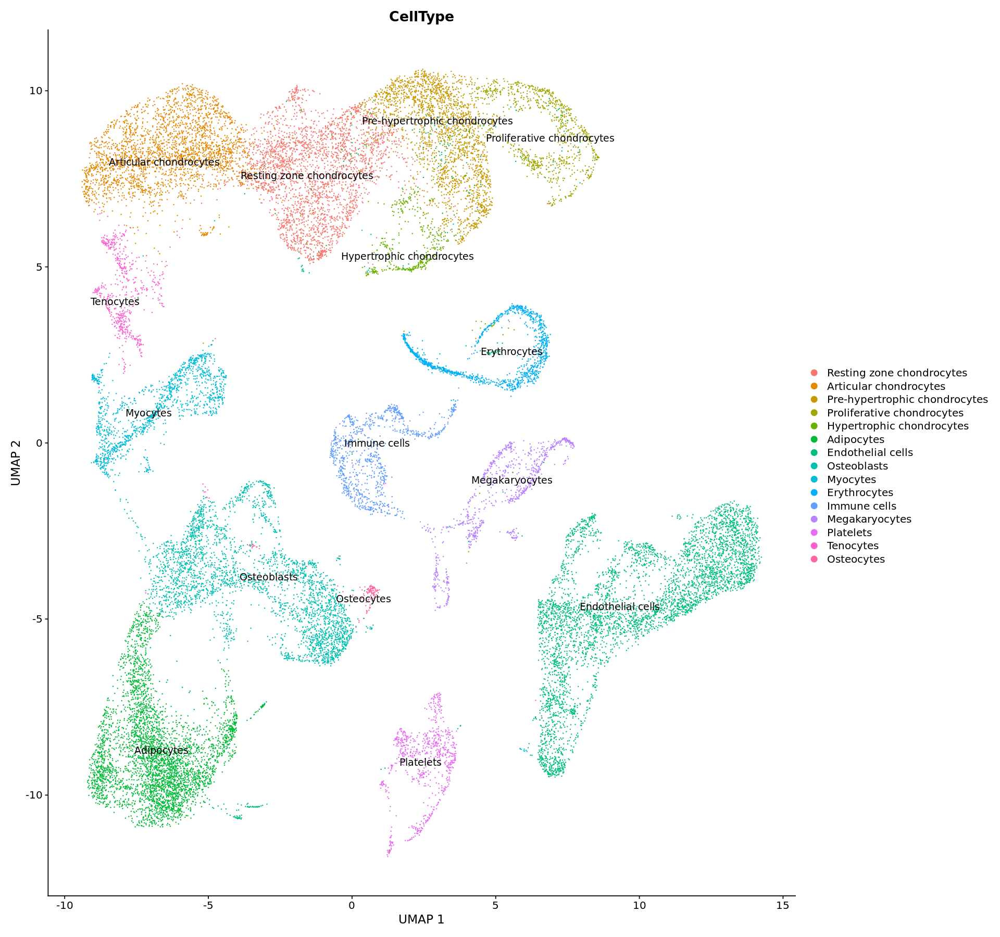

In [258]:
options(repr.plot.width=16)
DimPlot(MSC, group.by = "CellType", label = TRUE, repel = TRUE) + xlab("UMAP 1") + ylab("UMAP 2")

In [287]:
Idents(MSC) <- MSC$CellType

In [259]:
saveRDS(MSC, file = "MSC_seuratObject_EGFP.Rds")

In [374]:
MSC

An object of class Seurat 
16537 features across 27518 samples within 1 assay 
Active assay: RNA (16537 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

### Convert to celldataset

In [375]:
chondro.1 <- grep("Resting zone chondrocytes", MSC$CellType)
chondro.2 <- grep("Proliferative chondrocytes", MSC$CellType)
chondro.3 <- grep("Pre-hypertrophic chondrocytes", MSC$CellType)
chondro.4 <- grep("Hypertrophic chondrocytes", MSC$CellType)
chondro.5 <- grep("Articular chondrocytes", MSC$CellType)

gp.chondrocytes <- c(chondro.2, chondro.3, chondro.4)

In [376]:
barcodes <- rownames(MSC@meta.data[gp.chondrocytes,])

### subset SeuratObject on GP chondrocyte barcodes

In [377]:
gp <- subset(MSC, cells = barcodes)
gp

An object of class Seurat 
16537 features across 3474 samples within 1 assay 
Active assay: RNA (16537 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [378]:
gp <- ScaleData(gp)

Centering and scaling data matrix



In [379]:
gp <- RunUMAP(gp, dims=1:15)

16:24:31 UMAP embedding parameters a = 0.9922 b = 1.112

16:24:31 Read 3474 rows and found 15 numeric columns

16:24:31 Using Annoy for neighbor search, n_neighbors = 30

16:24:31 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:24:31 Writing NN index file to temp file /tmp/RtmpTslOeB/file23e28c2d80c

16:24:31 Searching Annoy index using 1 thread, search_k = 3000

16:24:32 Annoy recall = 100%

16:24:33 Commencing smooth kNN distance calibration using 1 thread

16:24:34 Initializing from normalized Laplacian + noise

16:24:34 Commencing optimization for 500 epochs, with 143132 positive edges

16:24:38 Optimization finished



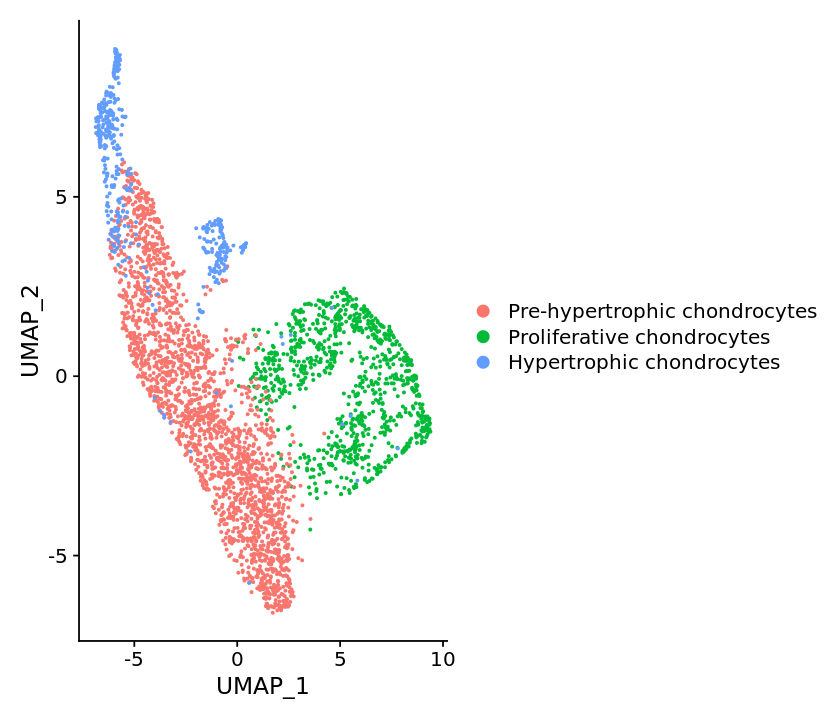

In [380]:
DimPlot(gp)

In [381]:
suppressPackageStartupMessages(library(monocle3))

In [382]:
cds <- as.cell_data_set(gp, assay = NULL)
cds <- cluster_cells(cds)
p1 <- plot_cells(cds, show_trajectory_graph = FALSE)
p2 <- plot_cells(cds, color_cells_by = "partition", show_trajectory_graph = FALSE)

Cells aren't colored in a way that allows them to be grouped.



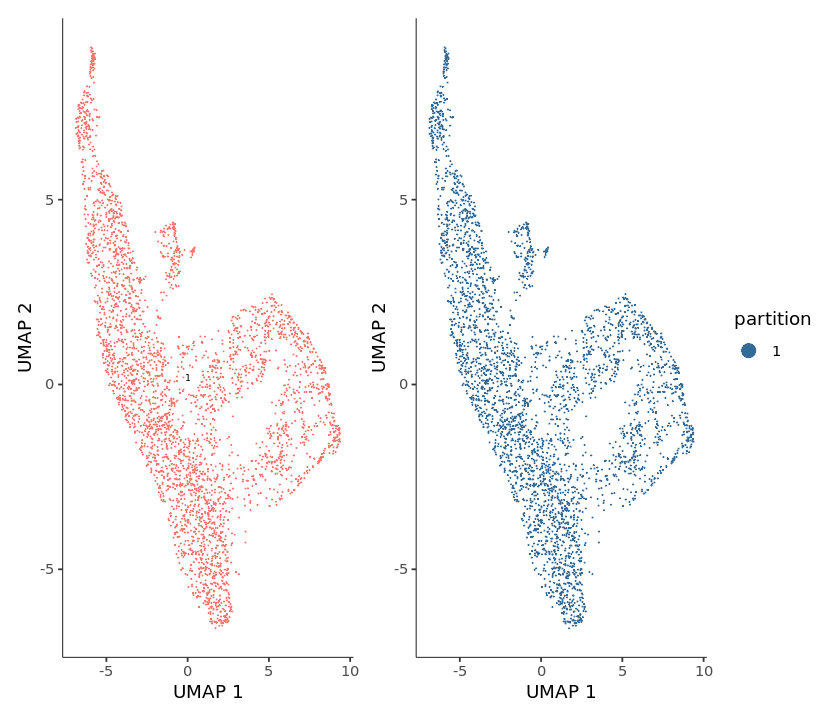

In [383]:
p1 + p2

  |======================================================================| 100%


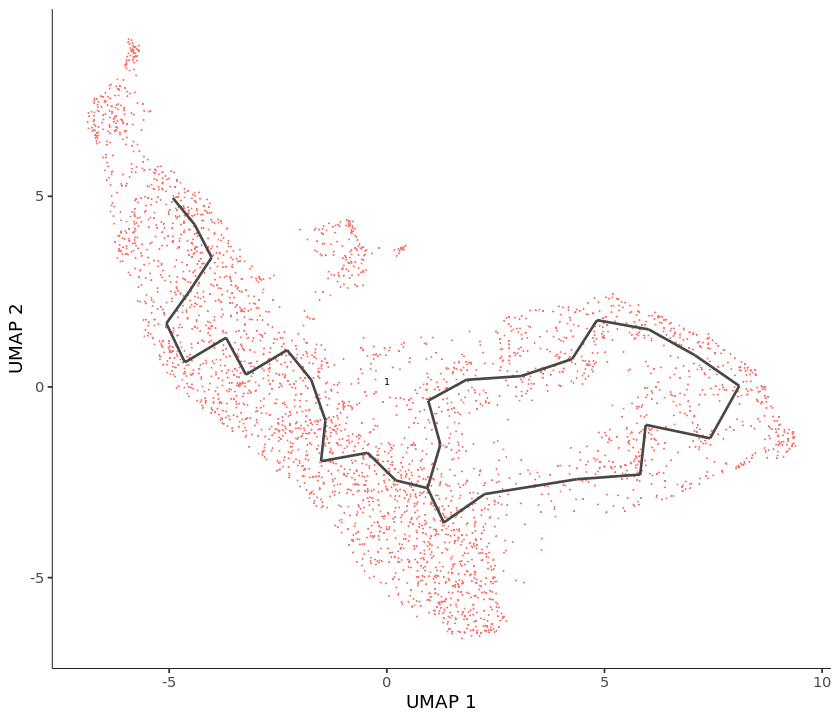

In [390]:
# gp.sub <- subset(as.Seurat(cds), monocle3_partitions == 1)
# cds@clusters$UMAP$partitions[cds@clusters$UMAP$partitions == "2"] <- "1"
# cds <- as.cell_data_set(gp)

cds <- learn_graph(cds)
plot_cells(cds, label_groups_by_cluster = FALSE, label_leaves = FALSE, label_branch_points = FALSE)

In [391]:
barcodes <- rownames(gp@meta.data[grep("Proliferative chondrocytes", gp$CellType),])

cds <- order_cells(cds, root_cells = barcodes)

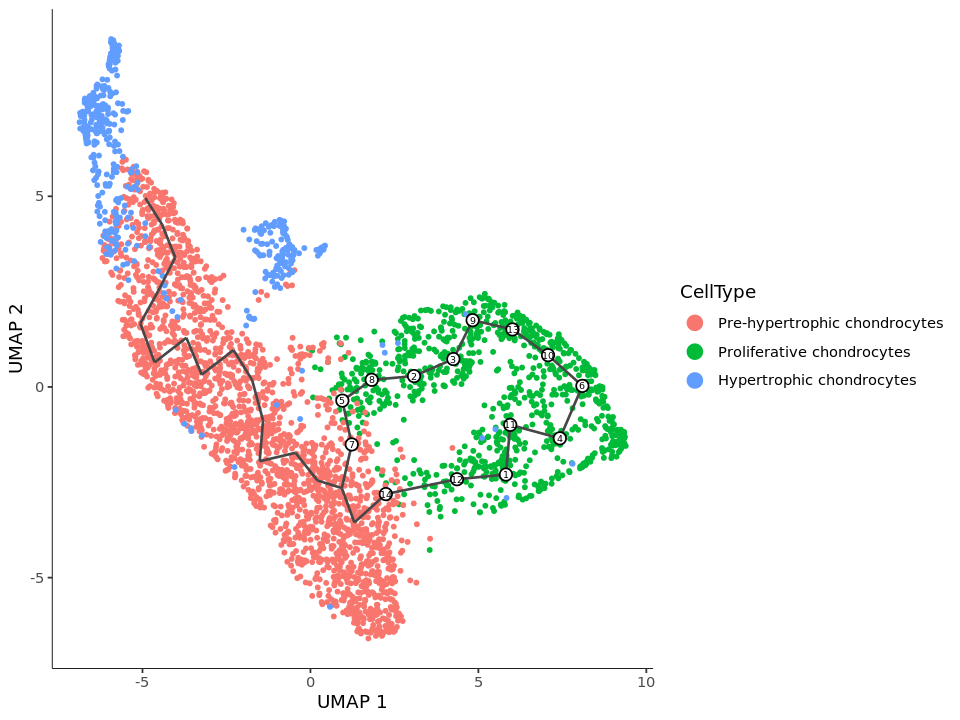

In [392]:
options(repr.plot.width = 8, repr.plot.height = 6)
plot_cells(cds, color_cells_by = "CellType", label_cell_groups = FALSE, label_leaves = FALSE, 
    label_branch_points = FALSE, cell_size = 1)

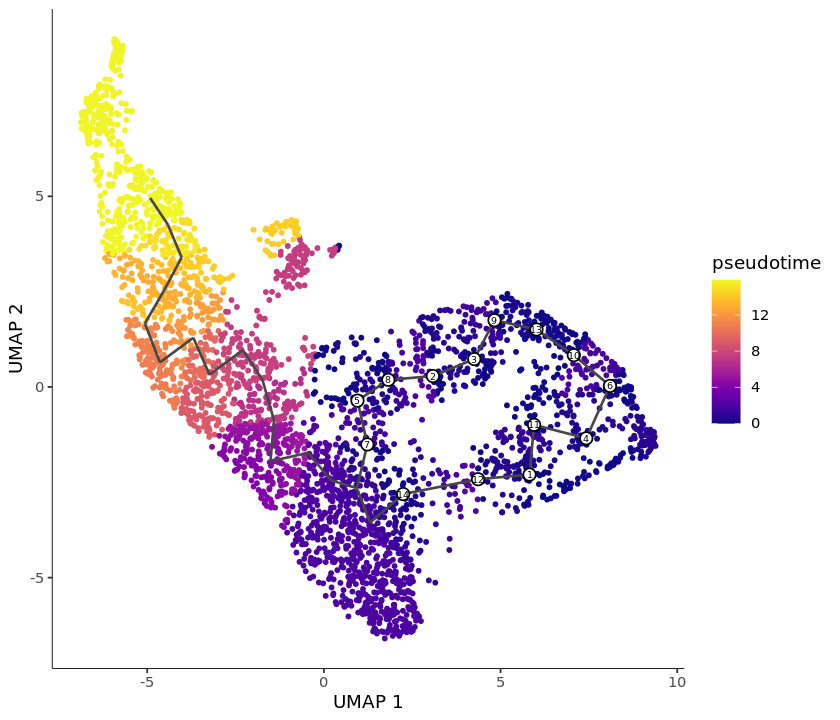

In [393]:
options(repr.plot.width = 7, repr.plot.height = 6)
plot_cells(cds, color_cells_by = "pseudotime", label_cell_groups = FALSE, label_leaves = FALSE, 
    label_branch_points = FALSE, cell_size = 1)

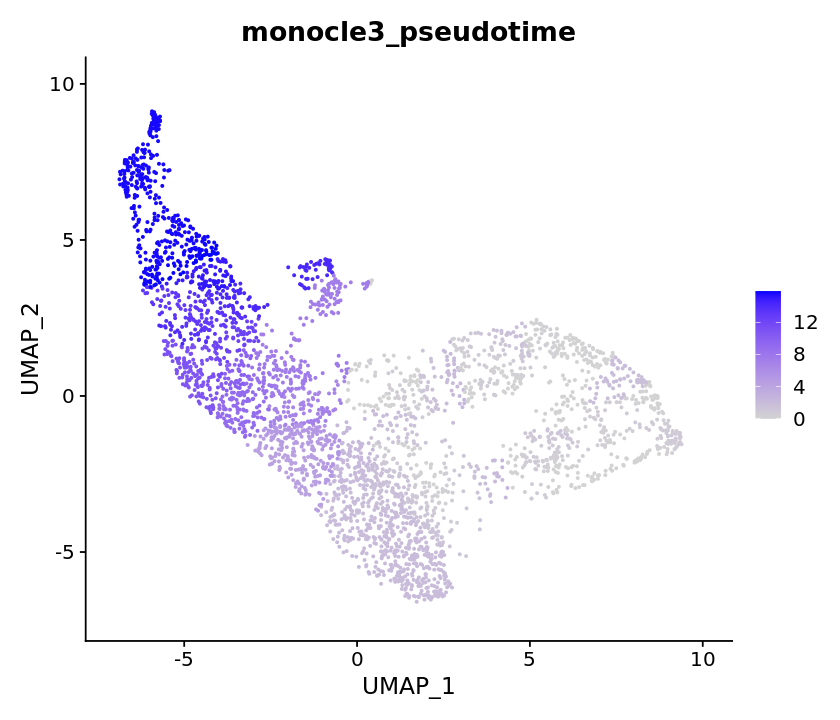

In [394]:
gp.finished <- as.Seurat(cds, assay = NULL)
FeaturePlot(gp.finished, "monocle3_pseudotime")

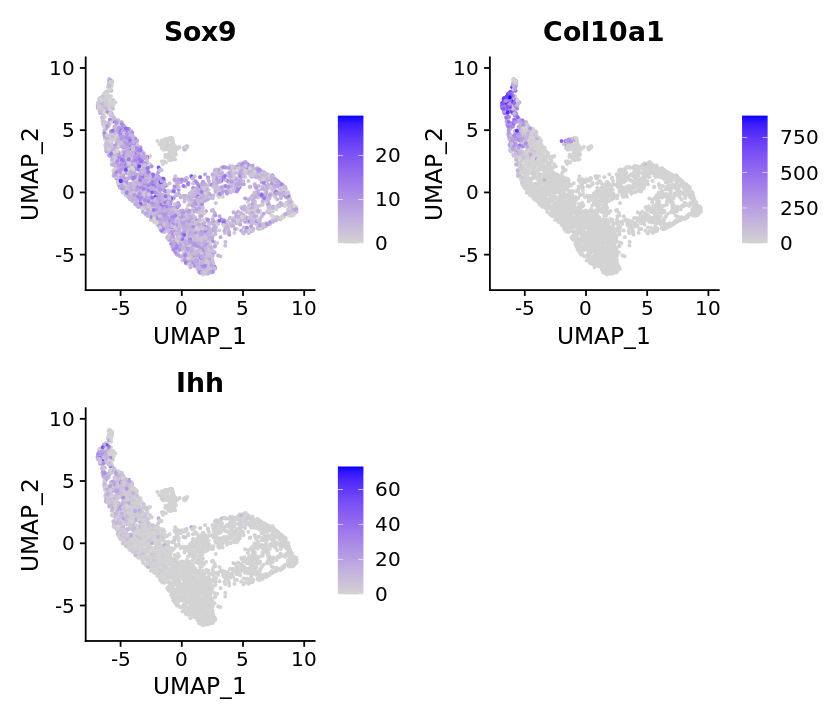

In [395]:
FeaturePlot(gp.finished, c("Sox9","Col10a1","Ihh"))

In [333]:
saveRDS(gp.finished, file = "MSC_seuratObject_EGFP+pseudotime.Rds")

### Add PCA for tSNE (Gabriele)

In [398]:
gp.finished <- ScaleData(gp.finished)
gp.finished <- RunPCA(gp.finished, features = rownames(gp.finished), verbose = F)
gp.finished

Centering and scaling data matrix



An object of class Seurat 
16537 features across 3474 samples within 1 assay 
Active assay: RNA (16537 features, 0 variable features)
 2 dimensional reductions calculated: UMAP, pca

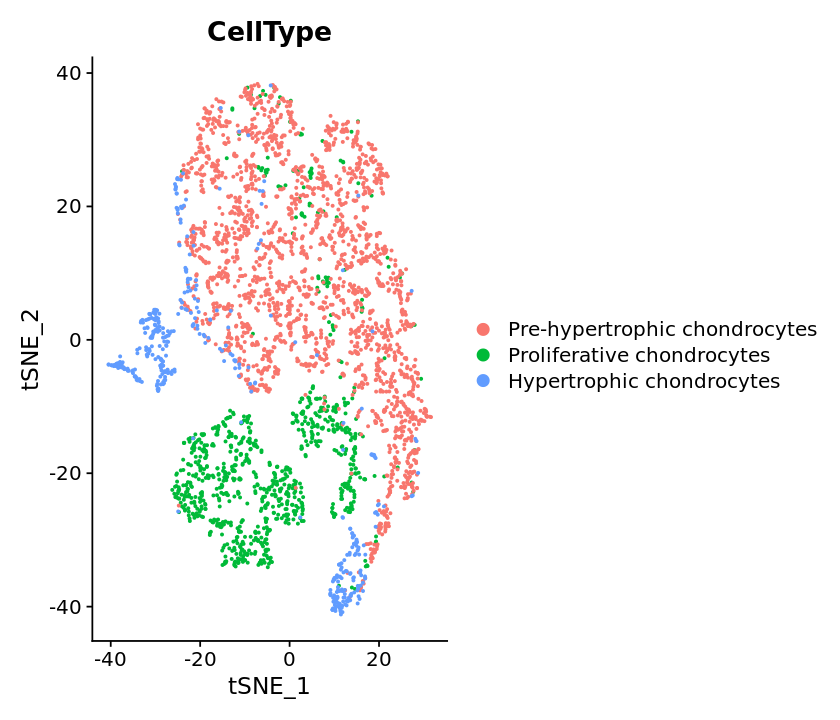

In [401]:
gp.finished <- RunTSNE(gp.finished)
DimPlot(gp.finished, reduction = "tsne", group.by = "CellType")

In [399]:
saveRDS(gp.finished, file = "MSC_visualization.Rds")